# **Installing required package**

In [ ]:
#------------------------Colour analysis package------------------------#
!pip install easydev                 #version 0.12.0
!pip install colormap                #version 1.0.4
!pip install colorgram.py            #version 1.2.0
!pip install extcolors

#-----------------------preparing environment for detectron2--------------------#

!pip install pyyaml==5.1
# workaround: install old version of pytorch since detectron2 hasn't released packages for pytorch 1.9 (issue: https://github.com/facebookresearch/detectron2/issues/3158)
!pip install torch==1.8.0+cu101 torchvision==0.9.0+cu101 -f https://download.pytorch.org/whl/torch_stable.html

# install detectron2 that matches pytorch 1.8
# See https://detectron2.readthedocs.io/tutorials/install.html for instructions
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html
exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.8/index.html


Restart the run time

In [ ]:
# check pytorch installation:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.8")   # please manually install torch 1.8 if Colab changes its default version

1.8.0+cu101 True


# **Importing packages**

In [ ]:
#------------------------Colour analysis package------------------------#
import pandas
import csv
import random
import tarfile
import multiprocessing as mp
import tqdm
import requests
import sklearn.model_selection as skms
import torch
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import tensorflow as tf
import numpy as np
import pandas as pd
import keras
from keras.layers import Conv2D, MaxPool2D, Flatten, Dense,Activation, Dropout, BatchNormalization
#from keras.preprocessing.image import ImageDataGenerator,img_to_array, load_img
from tensorflow.keras.utils import img_to_array
from keras.models import Sequential
from keras import regularizers
from sklearn.model_selection import train_test_split
import cv2
import seaborn as sns
from numpy import floor
from PIL import Image 
from glob import glob
import glob
import os
import shutil, sys
import matplotlib.pyplot as plt
import pylab
import scipy.stats as stats
import matplotlib.patches as patches
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
%matplotlib inline
import extcolors

from colormap import rgb2hex
import PIL
from pathlib import Path
from PIL import UnidentifiedImageError
from PIL import Image
import cv2

import cv2
import numpy as np
import glob

from tensorflow_hub import KerasLayer

import matplotlib.pyplot as plt

from scipy.stats import shapiro
import warnings
warnings.filterwarnings("ignore")

# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

#library for testing

from pyparsing.helpers import empty
from scipy.spatial import distance
import warnings
from collections import Counter
from itertools import groupby
from statistics import mean
import statistics
from collections import Counter
from itertools import groupby
from scipy.stats import pearsonr
import scipy.stats
from PIL import  Image, ImageOps, ImageEnhance
warnings.simplefilter(action='ignore', category=FutureWarning)
from pandas.core.common import SettingWithCopyWarning
warnings.simplefilter(action="ignore", category=SettingWithCopyWarning)

## **Functions**

In [ ]:

def rgb_to_hsv(r, g, b):
    """
    Converting RGB to HSV
    Arguments:
        r: an integer
        g: an integer
        b: an integer
    Returns:
        the HSV color value in list
    """
    r, g, b = r/255.0, g/255.0, b/255.0
    maximum = max(r, g, b)
    minimum = min(r, g, b)
    difference = maximum-minimum
    if maximum == minimum:
        h = 0
    elif maximum == r:
        h = (60 * ((g-b)/difference) + 360) % 360
    elif maximum == g:
        h = (60 * ((b-r)/difference) + 120) % 360
    elif maximum == b:
        h = (60 * ((r-g)/difference) + 240) % 360
    if maximum == 0:
        s = 0
    else:
        s = (difference/maximum)*100
    v = maximum*100
    return round(h), round(s), round(v)

def average(a, b):
    """
    Sum up two integers
    Arguments:
        a: an integer
        b: an integer
    Returns:
        The sum of the two integer arguments
    """
    return (a + b)

def calculate_rank(vector):
  """
  Rank the given list
  Arguments:
      vector: an list
  Returns:
      The list of vector rank
  """
  a={}
  rank=1
  for num in sorted(vector):
    if num not in a:
      a[num]=rank
      rank=rank+1
  return[a[i] for i in vector]

#used to scale the value that can be convert the sum of total number of rows as maximum value and 
def change_value(old_value,old_min,old_max):
  """
  scale the value
  Arguments:
      old_value: an integer
      old_min: an integer
      old_max: an integer
  Returns:
      The scaled new_value 
  """
  old_value = old_value
  old_min = old_min
  old_max = old_max
  new_min = 0
  new_max = 1
  new_value = ( (old_value - old_min) / (old_max - old_min) ) * (new_max - new_min) + new_min
  return new_value

def euc_dis(ed1,ed2):
  """
  euclidean distance
  Arguments:
      ed1: an list
      ed2: an list
  Returns:
      the distance between ed1 and ed2 
  """
  forward = np.sqrt(np.square(ed2[0] - ed1[0]) + (np.square(ed2[1] - ed1[1])) + (np.square(ed2[2] - ed1[2])))

  maximun = max(ed1[0],ed2[0])
  minimun = min(ed1[0],ed2[0])
  backword = np.sqrt(np.square((((360 - (abs(maximun))) + minimun)) + (np.square(ed2[1] - ed1[1])) + (np.square(ed2[2] - ed1[2]))))

  lowest_distance=min(backword,forward)
  return lowest_distance

def skin(image):
  """
  euclidean distance
  Arguments:
      image:array
  Returns:
      store the image to path 
  """
  # minRange for min skin color Rnage
  # maxRange for maximum skin color Range
  minRange = np.array([0,133,77],np.uint8)
  maxRange = np.array([235,173,127],np.uint8)
  #image = cv2.imread(img)

  # change our image bgr to ycr using cvtcolor() method 
  YCRimage = cv2.cvtColor(image,cv2.COLOR_BGR2YCR_CB)

  # apply min or max range on skin area in our image
  skinArea = cv2.inRange(YCRimage,minRange,maxRange)
  detectedSkin = cv2.bitwise_and(image, image, mask = skinArea)
  cv2.imwrite(name, np.hstack([detectedSkin]))

#functions for test data

def Color_cast(img):
  """
  Colour cast
  Arguments:
      ed1: image
  Returns:
      the colour cast value
  """
  img = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
  l_channel, a_channel, b_channel = cv2.split(img)
  h,w,_ = img.shape
  da = a_channel.sum()/(h*w)-128
  db = b_channel.sum()/(h*w)-128
  histA = [0]*256
  histB = [0]*256
  for i in range(h):
      for j in range(w):
          ta = a_channel[i][j]
          tb = b_channel[i][j]
          histA[ta] += 1
          histB[tb] += 1
  msqA = 0
  msqB = 0
  for y in range(256):
      msqA += float(abs(y-128-da))*histA[y]/(w*h)
      msqB += float(abs(y - 128 - db)) * histB[y]/(w * h)
  import math
  result = math.sqrt(da*da+db*db)/math.sqrt(msqA*msqA+msqB*msqB)
  #print("d/m = %s"%result)
  return result

#used to scale the value that can be convert the sum of total number of rows as maximum value and 
def change_value_final(old_value,old_min,old_max):
  """
  scale value
  Arguments:
      old_value: an integer
      old_min: an integer
      old_max: an integer
  Returns:
      returns the rescaled value
  """
  old_value = old_value
  old_min = old_min
  old_max = old_max
  new_min = 0
  new_max = 100
  new_value = ( (old_value - old_min) / (old_max - old_min) ) * (new_max - new_min) + new_min
  final_resu=(round(new_value,2))
  print(final_resu,"%")
  return None

def change_value_final_updated(old_value,old_min,old_max,new_min,new_max):
  """
  scale value
  Arguments:
      old_value: an integer
      old_min: an integer
      old_max: an integer
      new_min: an integer
      new_max: an integer
  Returns:
      returns the rescaled value
  """
  old_value = old_value
  old_min = old_min
  old_max = old_max
  new_min = new_min
  new_max = new_max
  new_value = ( (old_value - old_min) / (old_max - old_min) ) * (new_max - new_min) + new_min
  final_resu=(round(new_value,2))
  return final_resu

def percent(value,total_value):
  """
  percent
  Arguments:
      value: an integer
      total value: an integer
  Returns:
      returns the percentage
  """
  p=(value/total_value)*100
  return p


def euc_disance_new(ed1,ed2):
  """
  euclidean distance
  Arguments:
      ed1: an list
      ed2: an list
  Returns:
      returns the integer
  """
  forward = np.sqrt(np.square(ed2[0] - ed1[0]) + (np.square(ed2[1] - ed1[1])))

  maximun = max(ed1[0],ed2[0])
  minimun = min(ed1[0],ed2[0])
  backword = np.sqrt(np.square((((360 - (abs(maximun))) + minimun)) + (np.square(ed2[1] - ed1[1]))))

  lowest_distance=min(backword,forward)
  return lowest_distance

def background_png(bg):
  """
  remove background
  Arguments:
      bg: image array 
  Returns:
      returns the image
  """
  tmp = cv2.cvtColor(bg, cv2.COLOR_BGR2GRAY)
  _, alpha = cv2.threshold(tmp, 0, 255, cv2.THRESH_BINARY)
  b, g, r = cv2.split(bg)
  rgba = [b, g, r, alpha]
  dst = cv2.merge(rgba, 4)
  cv2_imshow(dst)
  pathssd="/content/Dissertation/backgroud/bg.png"
  cv2.imwrite(pathssd, dst)
  return pathssd

def get_num_pixels(filepath):
  """
  size of the image
  Arguments:
      filepath : string
  Returns:
      returns the integer
  """
  width, height = Image.open(filepath).size
  return width*height


def pearsonr_corr(list1,list2):
  """
  pearson correlation
  Arguments:
      list1: an list
      list2: an list
  Returns:
      returns the integer
  """
  corr, _ = pearsonr(list1, list2)
  print('Pearsons correlation: %.3f' % corr)

def spearmanr_corr(x,y):
  """
  Spearman correlation
  Arguments:
      list1: an list
      list2: an list
  Returns:
      returns the integer
  """
  sper=(scipy.stats.spearmanr(x, y)[0])
  print("spearmanr correlation: %.3f" % sper)


def multimodee(l):
  """
  multmode
  Arguments:
      list1: an list
  Returns:
      returns the dictionary
  """
  freqs = groupby(Counter(l).most_common(), lambda x:x[1])
  modee=([val for val,count in next(freqs)[1]])
  return modee

def image_colorfulness(image):
	(B, G, R) = cv2.split(image.astype("float"))
	rg = np.absolute(R - G)
	yb = np.absolute(0.5 * (R + G) - B)
	(rbMean, rbStd) = (np.mean(rg), np.std(rg))
	(ybMean, ybStd) = (np.mean(yb), np.std(yb))
	stdRoot = np.sqrt((rbStd ** 2) + (ybStd ** 2))
	meanRoot = np.sqrt((rbMean ** 2) + (ybMean ** 2))
	return stdRoot + (0.3 * meanRoot)
 

def user_rating_mean(file):
  """
  user rating mean
  Arguments:
      list1: an string
  Returns:
      returns the dictionary
  """
  new=testing_final[testing_final.File1.str.startswith(str(file))]
  unique_values=(new["File1"].unique().tolist())
  len(unique_values)
  user_rating_mean_d={}
  for imagg in unique_values:
    testing_final_classes_1 = testing_final[testing_final["File1"] == imagg]
    user_rating_mean_d[imagg]=mean(testing_final_classes_1["Score1"])

def user_rating_mode(file_1):
  """
  user_rating_mode
  Arguments:
      list1: an string
  Returns:
      returns the dictionary
  """
  new=testing_final[testing_final.File1.str.startswith(str(file_1))]
  unique_values=(new["File1"].unique().tolist())
  len(unique_values)
  user_rating_mode_d={}
  for imag in unique_values:
    testing_final_classes_1 = testing_final[testing_final["File1"] == imag]
    mm=multimodee(testing_final_classes_1["Score1"])
    user_rating_mode_d[imag]=min(mm)
  print(user_rating_mode_d)

className={0: u'__background__',1: u'person', 2: u'bicycle', 3: u'car', 4: u'motorcycle', 5: u'airplane', 6: u'bus', 7: u'train', 8: u'truck', 9: u'boat', 10: u'traffic light', 11: u'fire hydrant', 12: u'stop sign', 13: u'parking meter', 14: u'bench', 15: u'bird', 16: u'cat', 17: u'dog', 18: u'horse', 19: u'sheep', 20: u'cow', 21: u'elephant', 22: u'bear', 23: u'zebra', 24: u'giraffe', 25: u'backpack', 26: u'umbrella', 27: u'handbag', 28: u'tie', 29: u'suitcase', 30: u'frisbee', 31: u'skis', 32: u'snowboard', 33: u'sports ball', 34: u'kite', 35: u'baseball bat', 36: u'baseball glove', 37: u'skateboard', 38: u'surfboard', 39: u'tennis racket', 40: u'bottle', 41: u'wine glass', 42: u'cup', 43: u'fork', 44: u'knife', 45: u'spoon', 46: u'bowl', 47: u'banana', 48: u'apple', 49: u'sandwich', 50: u'orange', 51: u'broccoli', 52: u'carrot', 53: u'hot dog', 54: u'pizza', 55: u'donut', 56: u'cake', 57: u'chair', 58: u'couch', 59: u'potted plant', 60: u'bed', 61: u'dining table', 62: u'toilet', 63: u'tv', 64: u'laptop', 65: u'mouse', 66: u'remote', 67: u'keyboard', 68: u'cell phone', 69: u'microwave', 70: u'oven', 71: u'toaster', 72: u'sink', 73: u'refrigerator', 74: u'book', 75: u'clock', 76: u'vase', 77: u'scissors', 78: u'teddy bear', 79: u'hair drier', 80: u'toothbrush'}

# **Generating training dataset**

### **Resizing training images**

In [ ]:
#resizing the image
from PIL import Image
i=0
import glob
for img in glob.glob("/content/Dissertation/Train_dataset/images/*.jpg"):
  base_width = 460
  image = Image.open(img)
  width_percent = (base_width / float(image.size[0]))
  hsize = int((float(image.size[1]) * float(width_percent)))
  image = image.resize((base_width, hsize), PIL.Image.ANTIALIAS)
  image.save('/content/Dissertation/Train_dataset/images/'+str(i)+'_resized_compressed.jpg')
  i=i+1

### **Train**

In [ ]:
import cv2
import glob
for img in glob.glob("/content/Dissertation/Train_dataset/opt_images/*.jpg"):
    img = cv2.imread(img)
    cfg = get_cfg()
    # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
    # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
    predictor = DefaultPredictor(cfg)
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    print(cv2_imshow(out.get_image()[:, :, ::-1]))
    masks = np.asarray(outputs["instances"].pred_masks.to("cpu"))
    instances = outputs["instances"]
    detected_class_indexes = instances.pred_classes.tolist()
    pred_class_names = list(map(lambda x: className[x+1], detected_class_indexes))
    print(pred_class_names)
    score=instances.scores.tolist()

    from PIL import Image
    for i in range(0,len(masks)):
      if score[i] >= 0.90:
        # Get the masks

        # Pick an item to mask
        item_mask = masks[i]
        mask = Image.fromarray((item_mask * 255).astype('uint8'))
        masked = cv2.bitwise_and(np.array(img),np.array(img),mask = np.array(mask))

        # Get the true bounding box of the mask (not the same as the bbox prediction)---------------------------------------
        segmentation = np.where(item_mask == True)
        x_min = int(np.min(segmentation[1]))
        x_max = int(np.max(segmentation[1]))
        y_min = int(np.min(segmentation[0]))
        y_max = int(np.max(segmentation[0]))

        #Get the mask and save the image--------------------------------------------------------------------------------------
        tmp = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)
        _,alpha = cv2.threshold(tmp,0,255,cv2.THRESH_BINARY)
        b, g, r = cv2.split(masked)
        rgba = [b,g,r, alpha]
        masked_tr = cv2.merge(rgba,4)
        plt.axis('off')
        plt.imshow(masked_tr)
        image_crop = masked_tr[ y_min:y_max,x_min:x_max]
        name= "/content/sample_data/"+pred_class_names[i]+"_"+str(i)+".png"
        if pred_class_names[i] == "person":
          skin(image_crop)
        else:
          cv2.imwrite(name, image_crop)
        sddc=cv2.imread(name)
        cv2_imshow(sddc)

      #Colour analysis-------------------------------------------------------------------------------
        colors_analysis = extcolors.extract_from_path(name, tolerance = 12)
        RBG_values=colors_analysis[0]
        total_pixels=colors_analysis[1]
      #creating the dataframe for all the colour values---------------------------------------------------------------------------
        csv_file_name="/content/Dissertation/Train_dataset/"+pred_class_names[i]+".csv"  #assign class name with .csv as extesion
        if os.path.exists(csv_file_name)==True:   #checkng if the csv with particular class name is already exist
          df_test=pd.read_csv(csv_file_name)      
          length_of_csv=(len(df_test))            
          for j in range(0,len(RBG_values)):      #for loop to iterate through dataframe and RGB values
            duplicate=str((rgb_to_hsv(RBG_values[j][0][0],RBG_values[j][0][1],RBG_values[j][0][2]))) in df_test["HSV"].values
            if duplicate ==True:                  #if to check the colour code already exist in the dtaframe
              ss=(df_test.index[(df_test["HSV"] == str((rgb_to_hsv(RBG_values[j][0][0],RBG_values[j][0][1],RBG_values[j][0][2]))))])
              df_test.at[ss[0],'pixels']=average(df_test["pixels"][ss[0]], (((RBG_values[j][1])/total_pixels)))
            else:
              df_test.at[j+length_of_csv,'pixels']=(((RBG_values[j][1])/total_pixels)) #round(2.665, 2)
              df_test.at[j+length_of_csv,'RGB']=(RBG_values[j][0])
              df_test.at[j+length_of_csv,'HSV']=(rgb_to_hsv(RBG_values[j][0][0],RBG_values[j][0][1],RBG_values[j][0][2]))
          df_test.head()
          df_test.to_csv(csv_file_name, index=False)
        else:
          df_test=pd.DataFrame(columns=["RGB","HSV","pixels"])
          for k in range(0,len(RBG_values)):
            df_test.at[k,'RGB']=(RBG_values[k][0])
            df_test.at[k,'HSV']=(rgb_to_hsv(RBG_values[k][0][0],RBG_values[k][0][1],RBG_values[k][0][2]))
            df_test.at[k,'pixels']=((RBG_values[k][1])/total_pixels) #round(2.665, 2)
          df_test.head()
          df_test.to_csv(csv_file_name, index=False)
        os.remove(name)

#---------------------------------adding Normalize value and ranking to each pixel values------------------------

Train_dataset_files = os.path.join("/content/Dissertation/Train_dataset/", "*.csv")

files = glob.glob(Train_dataset_files)

for train_csv_file in files:
  update_train_df=pd.read_csv(train_csv_file)
  update_train_df["pixels_normalize"] = round((update_train_df["pixels"] - update_train_df["pixels"].min()) / (update_train_df["pixels"].max() - update_train_df["pixels"].min()),4)
  #update_tain_df.drop(update_tain_df.loc[update_tain_df['pixels_normalize']<0.001].index, inplace=True)
  #update_train_df.insert(2,"Hue-color","")
  update_train_df["RANK"]=calculate_rank(list(update_train_df["pixels"]))
  update_train_df["nor_rank"]=""
  for index,row in update_train_df.iterrows():
    HSV_value=((update_train_df["HSV"][index]))
    strippedText = str(HSV_value).replace('[','').replace(']','').replace('(','').replace(')','')
    HSV_list=list(strippedText.split(","))
    HSV_list=list(map(int, HSV_list))
    update_train_df["Hue-color"][index]=int(HSV_list[0])
    update_train_df["nor_rank"][index]=change_value(update_train_df["RANK"][index],(min(update_train_df["RANK"])),(max(update_train_df["RANK"])))    
  update_train_df.to_csv(train_csv_file, index=False)

### **Visualization**

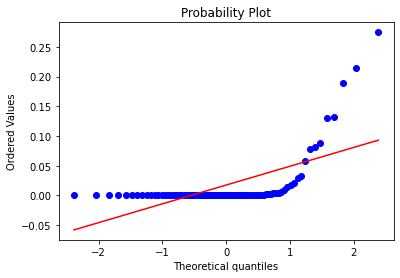

S-W statistic: 0.4088864326477051
p-value: 1.945198060828598e-16
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



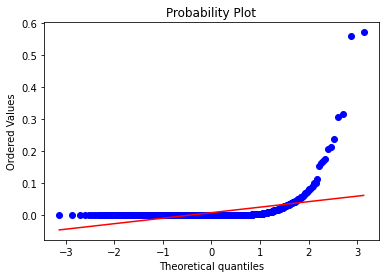

S-W statistic: 0.20237469673156738
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



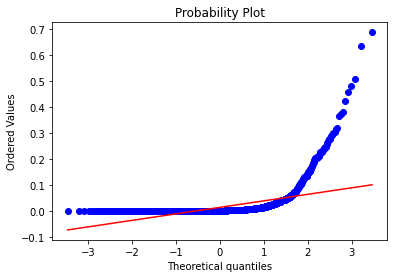

S-W statistic: 0.3161584138870239
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



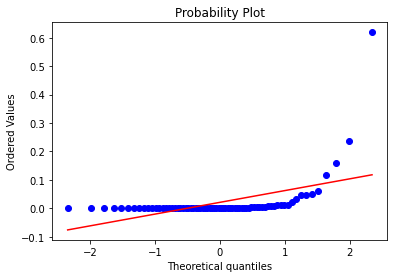

S-W statistic: 0.27379119396209717
p-value: 4.160095117832109e-17
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



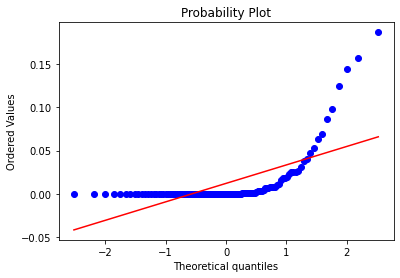

S-W statistic: 0.4449175000190735
p-value: 3.5698041744825157e-19
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



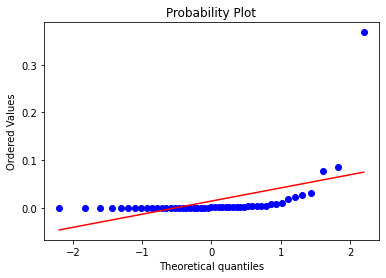

S-W statistic: 0.26710283756256104
p-value: 3.0315465036293704e-14
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



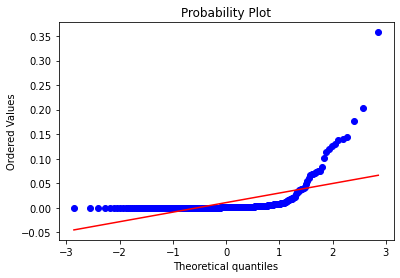

S-W statistic: 0.3426876664161682
p-value: 1.528922008823569e-32
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



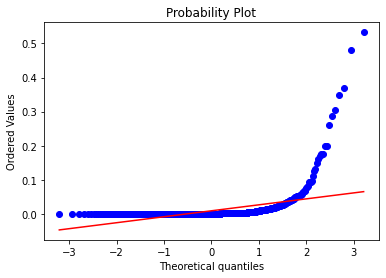

S-W statistic: 0.23280906677246094
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



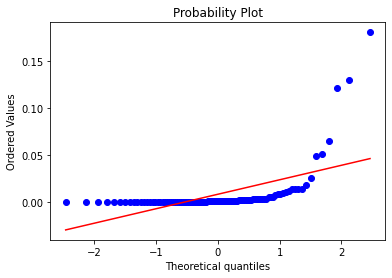

S-W statistic: 0.3429030179977417
p-value: 4.022146858481373e-19
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



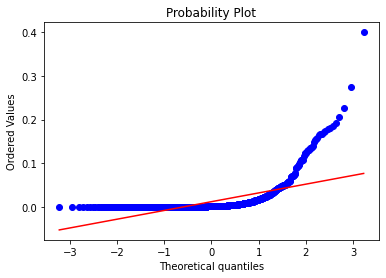

S-W statistic: 0.4093456268310547
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
sv


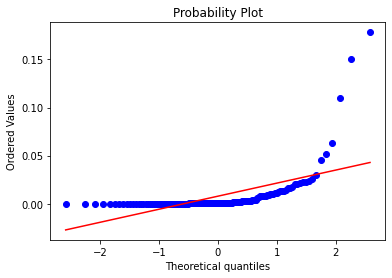

S-W statistic: 0.3538457751274109
p-value: 2.2426028114436045e-22
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



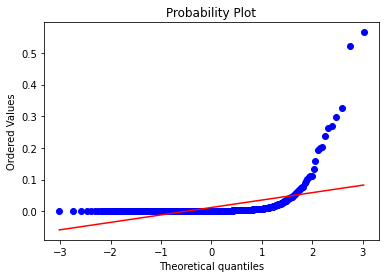

S-W statistic: 0.25054144859313965
p-value: 4.732184914024907e-42
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



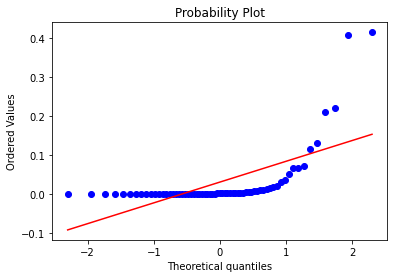

S-W statistic: 0.42358213663101196
p-value: 1.498148698467986e-14
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



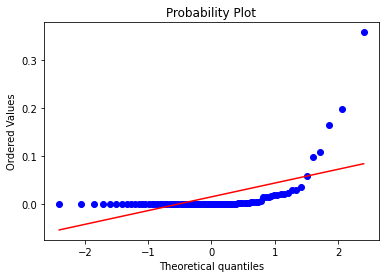

S-W statistic: 0.33991700410842896
p-value: 1.000498608248406e-17
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



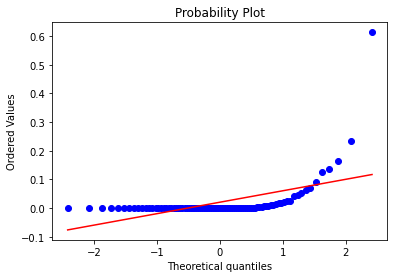

S-W statistic: 0.2992691397666931
p-value: 1.2629844405893468e-18
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



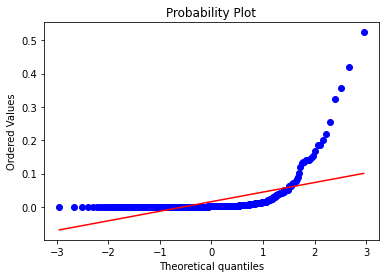

S-W statistic: 0.33046507835388184
p-value: 3.9191071518882986e-37
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



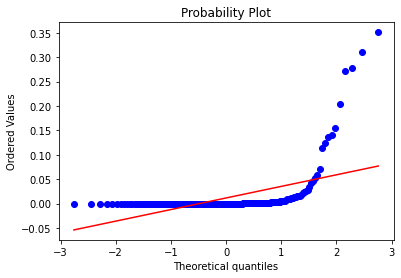

S-W statistic: 0.27315908670425415
p-value: 1.4629412005814053e-29
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



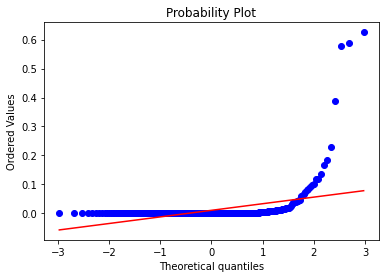

S-W statistic: 0.17624342441558838
p-value: 5.556008281201467e-41
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



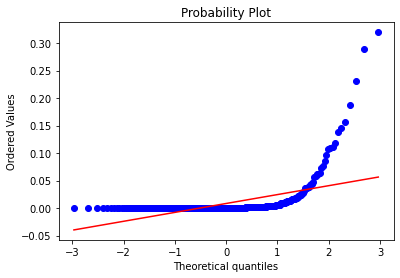

S-W statistic: 0.28393661975860596
p-value: 1.031737243314901e-38
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
sv


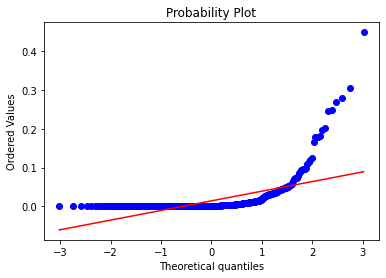

S-W statistic: 0.37396901845932007
p-value: 1.5894213818619594e-39
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



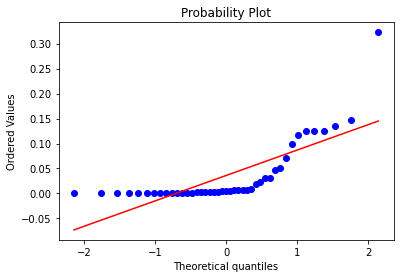

S-W statistic: 0.6104563474655151
p-value: 1.8487671393785376e-09
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



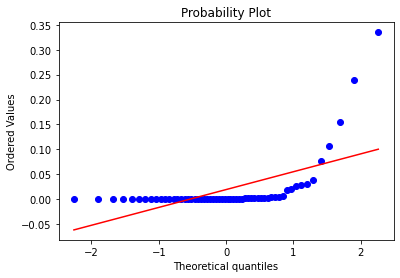

S-W statistic: 0.377061665058136
p-value: 2.761771083906791e-14
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



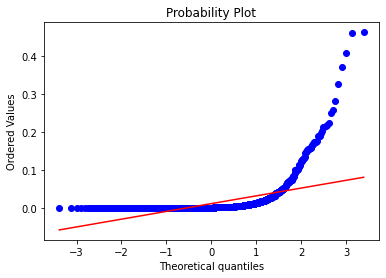

S-W statistic: 0.33824121952056885
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



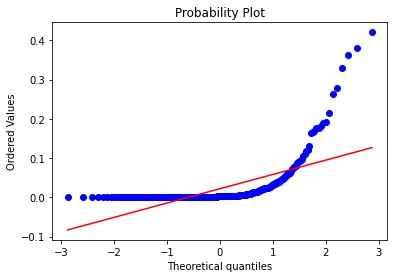

S-W statistic: 0.42947179079055786
p-value: 1.6034619864001715e-31
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



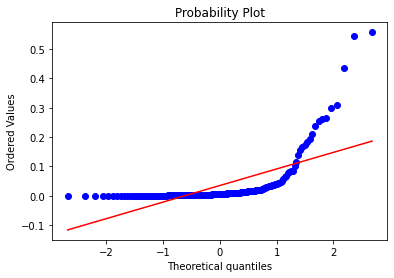

S-W statistic: 0.44607704877853394
p-value: 8.558452934938625e-24
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



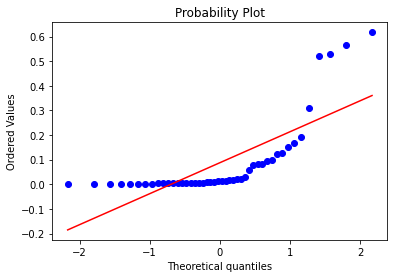

S-W statistic: 0.5854527950286865
p-value: 3.537926063224006e-10
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



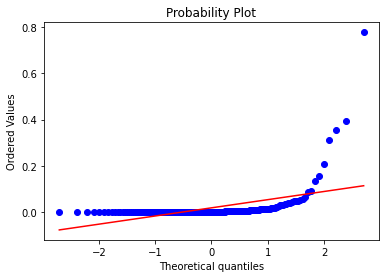

S-W statistic: 0.24658042192459106
p-value: 5.588814698123515e-28
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
csv


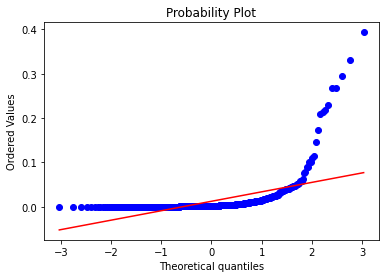

S-W statistic: 0.3221917152404785
p-value: 2.0621508201004008e-41
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



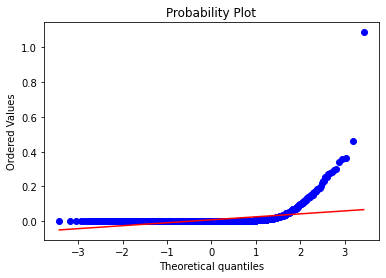

S-W statistic: 0.19772392511367798
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



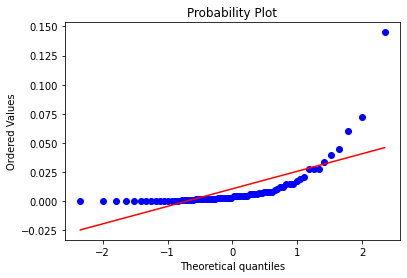

S-W statistic: 0.507236123085022
p-value: 3.662578595443888e-14
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



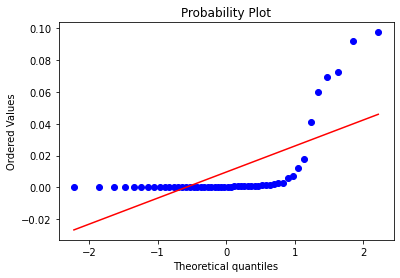

S-W statistic: 0.4537231922149658
p-value: 1.2352604833107406e-12
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



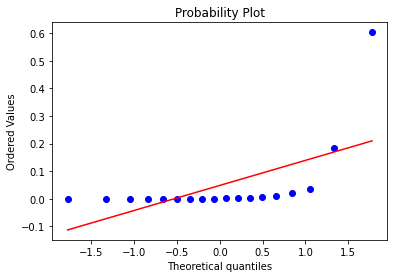

S-W statistic: 0.38264739513397217
p-value: 8.948816088150124e-08
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



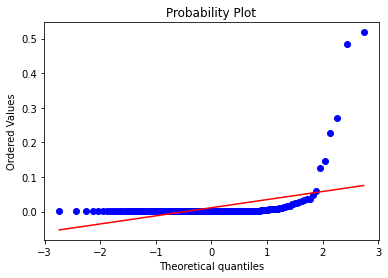

S-W statistic: 0.19174563884735107
p-value: 6.940524145786045e-30
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



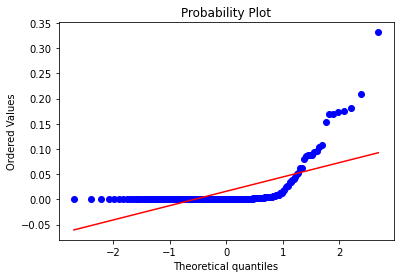

S-W statistic: 0.41431790590286255
p-value: 6.954174713768015e-25
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



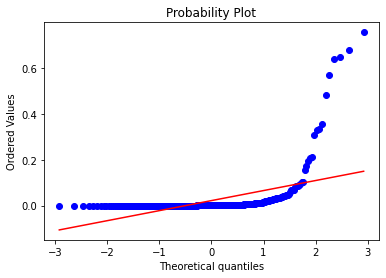

S-W statistic: 0.2595425248146057
p-value: 5.422207147049385e-37
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



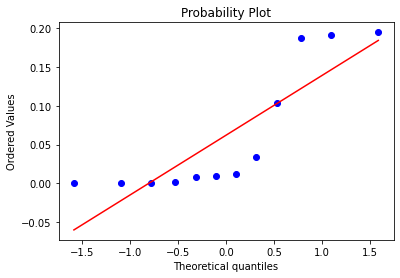

S-W statistic: 0.7146002054214478
p-value: 0.0011691312538459897
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



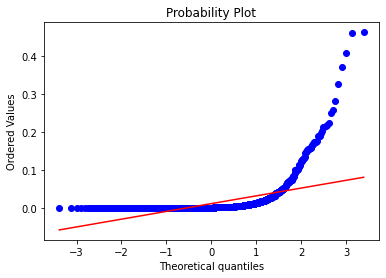

S-W statistic: 0.33824121952056885
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
sv


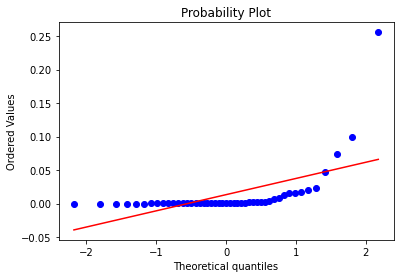

S-W statistic: 0.354266881942749
p-value: 4.347778376472683e-13
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



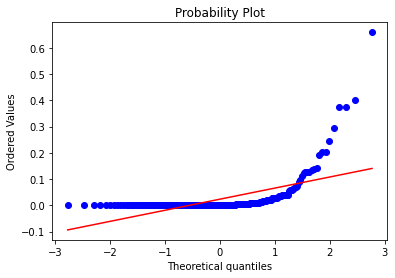

S-W statistic: 0.364085853099823
p-value: 1.8166844571867865e-28
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



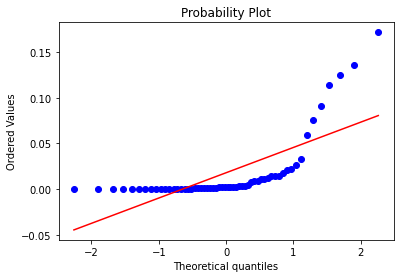

S-W statistic: 0.5315861701965332
p-value: 2.499548961906739e-12
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



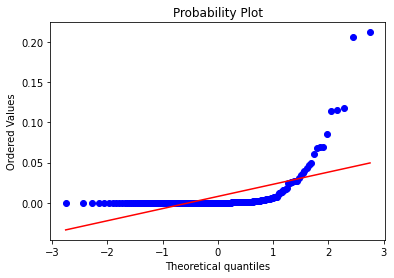

S-W statistic: 0.3400419354438782
p-value: 3.3025085944024287e-28
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



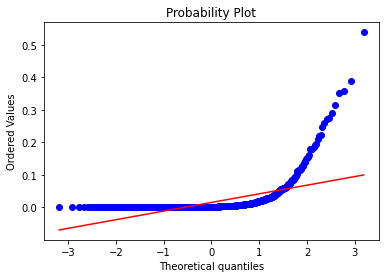

S-W statistic: 0.364480197429657
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



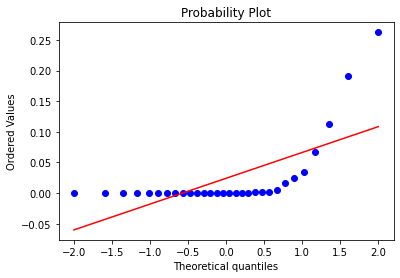

S-W statistic: 0.4640979766845703
p-value: 2.2817372435923744e-09
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



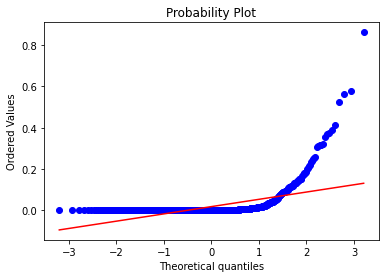

S-W statistic: 0.3218640685081482
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



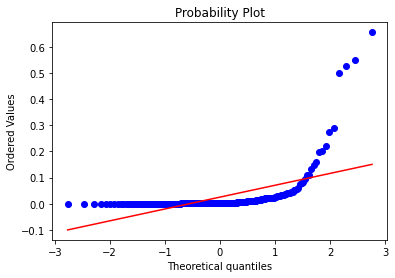

S-W statistic: 0.3212752342224121
p-value: 4.782861345201999e-29
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



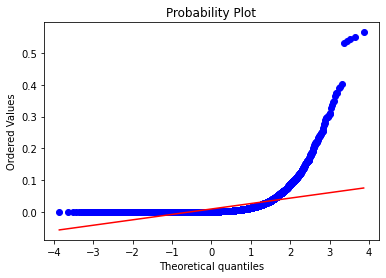

S-W statistic: 0.34300392866134644
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
.csv


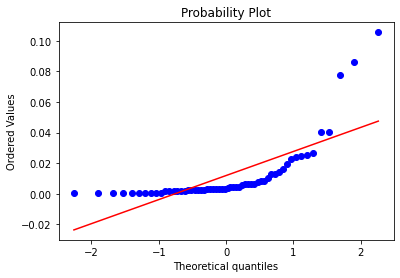

S-W statistic: 0.5581119060516357
p-value: 6.0007190189059756e-12
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



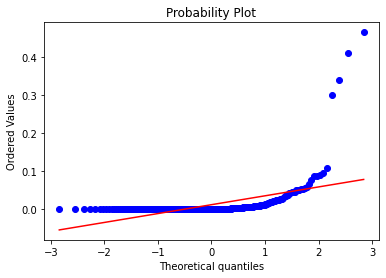

S-W statistic: 0.2621968984603882
p-value: 3.244965747098356e-33
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
csv


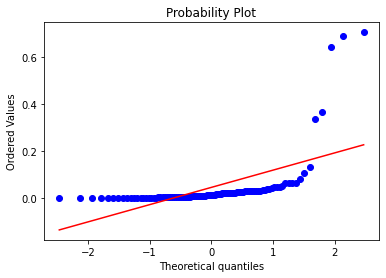

S-W statistic: 0.3553417921066284
p-value: 4.775150825085532e-19
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



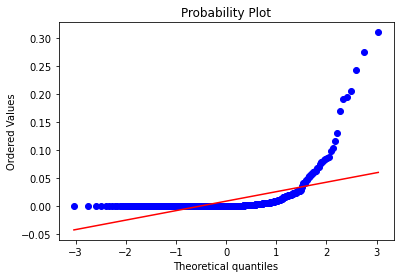

S-W statistic: 0.3250349164009094
p-value: 2.3655319376267237e-41
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



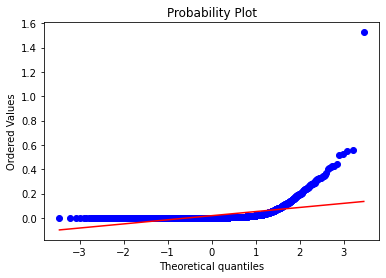

S-W statistic: 0.3136413097381592
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
sv


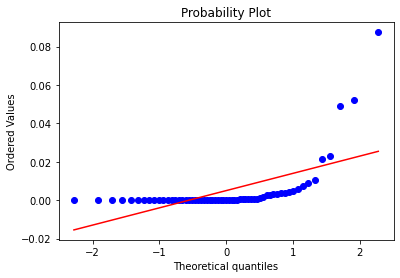

S-W statistic: 0.38200098276138306
p-value: 1.3619844252518894e-14
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



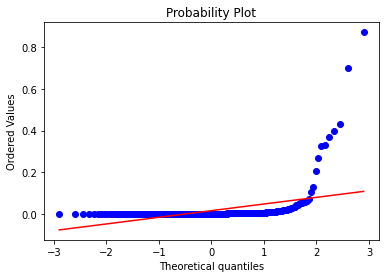

S-W statistic: 0.18760859966278076
p-value: 5.332632113470165e-37
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



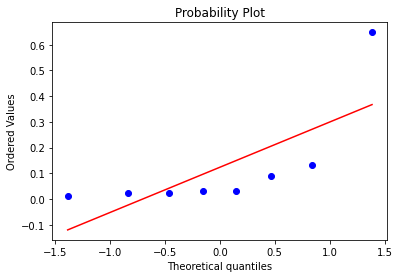

S-W statistic: 0.5715026259422302
p-value: 7.355231355177239e-05
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



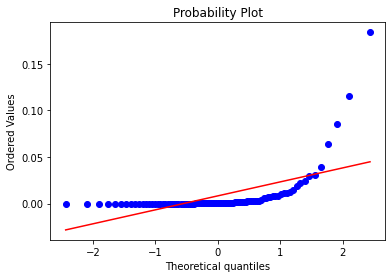

S-W statistic: 0.3597872257232666
p-value: 2.9847495118850513e-18
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



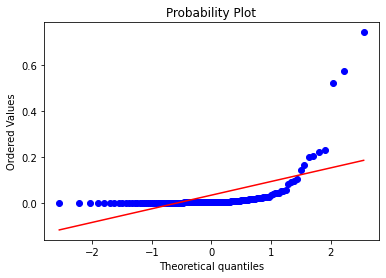

S-W statistic: 0.34779196977615356
p-value: 2.075722303548201e-21
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



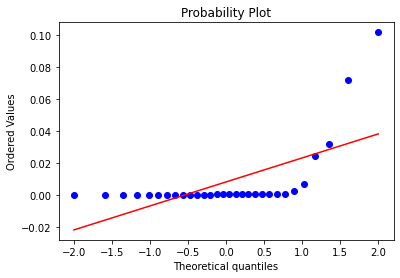

S-W statistic: 0.4180433750152588
p-value: 8.055822675601121e-10
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



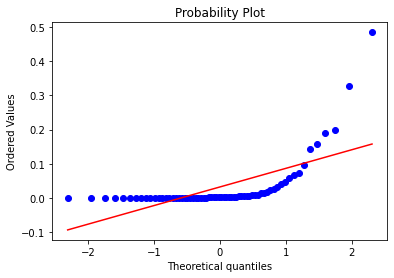

S-W statistic: 0.4490852355957031
p-value: 2.4648938285972734e-14
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
sv


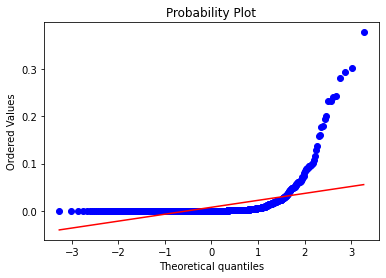

S-W statistic: 0.26437634229660034
p-value: 0.0
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



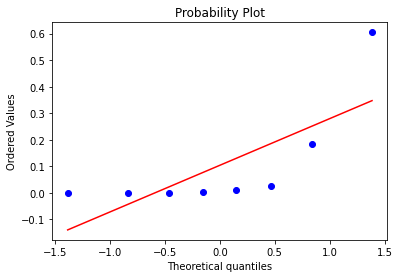

S-W statistic: 0.5848432779312134
p-value: 0.00010560535883996636
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



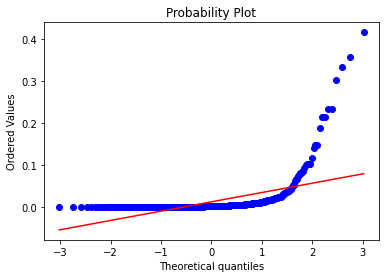

S-W statistic: 0.30346304178237915
p-value: 7.270076562763583e-41
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



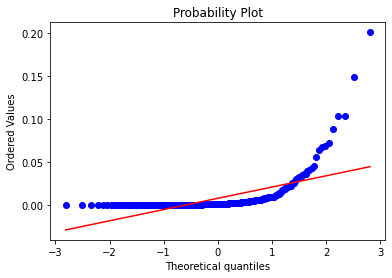

S-W statistic: 0.39609628915786743
p-value: 1.7946501334342952e-29
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



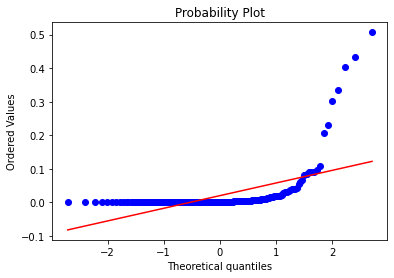

S-W statistic: 0.3222757577896118
p-value: 4.633583682807573e-27
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------
v


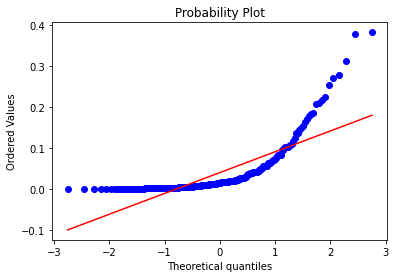

S-W statistic: 0.6249251961708069
p-value: 2.187544864097992e-22
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



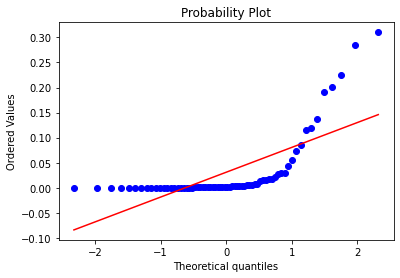

S-W statistic: 0.5190133452415466
p-value: 1.392998130039791e-13
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



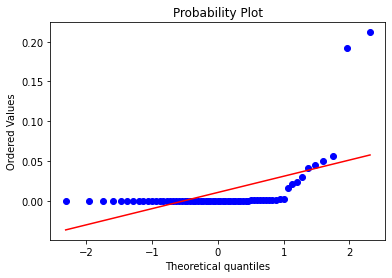

S-W statistic: 0.3201555013656616
p-value: 5.169705716097828e-16
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------



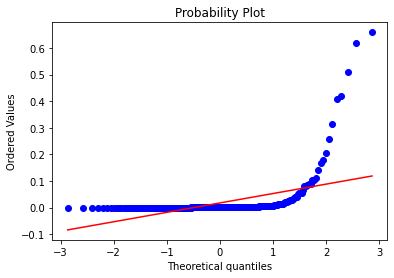

S-W statistic: 0.2478976845741272
p-value: 1.232345688690743e-34
the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution
---------------------------------------------------------------------------------------------------------------


In [ ]:
Train_dataset_files = os.path.join("/content/Dissertation/Train_dataset/", "*.csv")

files = glob.glob(Train_dataset_files)

for train_csv_file in files:
  update_train_df=pd.read_csv(train_csv_file)
  #update_train_df["pixels"].hist()
  print(train_csv_file[47:])
  stats.probplot(update_train_df["pixels"], dist="norm", plot=pylab)
  pylab.show()
  result = (shapiro(update_train_df["pixels"]))
  print(f"S-W statistic: {result[0]}")
  print(f"p-value: {result[1]}")
  if result[1] < 0.05:
    print("the p-value is less than the alpha(0.5). So,we have sufficient evidence to say that sample does not come from a normal distribution")
  print("---------------------------------------------------------------------------------------------------------------")

In [ ]:
df_test=pd.read_csv("/content/Dissertation/Train_dataset/boat.csv")

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots


fig = go.Figure()

fig = make_subplots(rows=1, cols=1, start_cell="bottom-left")

trace1 = px.bar(df_test, x="Hue-color", y="pixels_normalize", title="Hue-color",hover_data=["HSV","nor_rank"],color="pixels",range_color=[1,8])


fig.add_trace(trace1.data[0],row=1,col=1)

fig.update_xaxes(title_text="Hue-color",range=[1, 360], row=1, col=1)
fig.update_yaxes(title_text="Pixels", row=1,col=1)

#fig = px.colors.sequential.swatches_continuous()
fig.update_layout(height=500, width=1000,title={'text': "HSV",
                        'y':0.95,
                        'x':0.48,
                        'xanchor': 'center',
                        'yanchor': 'top'})

fig.show()

# **Testing image**

### **User rating data preprocessing**

In [ ]:
import pandas as pd
testing_df = pd.read_csv("/content/Dissertation/clean_raw_data.csv")
testing_df = testing_df.drop(["ID","SurNum","Date"], axis=1)
testing_df_1=testing_df[["File2","Score2"]]
testing_df_1.rename(columns = {"File2":"File1","Score2":"Score1"}, inplace = True)
testing_df = testing_df.drop(["File2","Score2"], axis=1)
testing_final = pd.concat([testing_df,testing_df_1],ignore_index=True)
testing_final

,File1,Score1
0,118020_gt.jpg,5
1,239096_gt.jpg,5
2,151087G_4.jpg,5
3,022090AF_11.jpg,4
4,187029_gt.jpg,5
...,...,...
50675,046076_gt.jpg,3
50676,118020AD_4.jpg,2
50677,323016_gt.jpg,4
50678,376001_gt.jpg,3


# **Testing**

In [ ]:
def Test(file_location,df_name):
  compare=pd.DataFrame(columns=["filename","user_ratings_mean","user_ratings_mode","new_colour_value","out_of_5","object_score","background_score"])
  cal_nam=len(file_location) + 1
  for img in glob.glob( str(file_location)+"/*.jpg"):
    img_inp=img
    im_test = cv2.imread(img_inp)
    background = im_test
    all_masks=[]
    max_value_updated=[]
    cfg = get_cfg()
    # add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
    cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
    # Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
    predictor = DefaultPredictor(cfg)
    outputs = predictor(im_test)
    # We can use `Visualizer` to draw the predictions on the image.
    v = Visualizer(im_test[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

    instances_test = outputs["instances"]
    detected_class_indexes = instances_test.pred_classes.tolist()

    pred_class_names = list(map(lambda x: className[x+1], detected_class_indexes))

    score_test=instances_test.scores.tolist()

    print("==============================================================================================================================================")
    print("==============================================================================================================================================")
    print("==================================================================",[img_inp[cal_nam:]],"=====================================================================")
    print("==============================================================================================================================================")
    print("=========================================================Predicted class and Accuracy=========================================================")
    for i in range(len(pred_class_names)):
      print(pred_class_names[i],"--",score_test[i])

    #-----------------------------------------------------Cropping the mask and getting the color of each mask------------------------------------

    masks_test = np.asarray(outputs["instances"].pred_masks.to("cpu"))
    from PIL import Image
    for i in range(0,len(masks_test)):
      if score_test[i] >= 0.90:
        # Get the masks_test

        # Pick an item to mask
        item_mask = masks_test[i]
        mask = Image.fromarray((item_mask * 255).astype('uint8'))
        masked = cv2.bitwise_and(np.array(im_test),np.array(im_test),mask = np.array(mask))
        all_masks.append(mask)

        # Get the true bounding box of the mask (not the same as the bbox prediction)---------------------------------------
        segmentation = np.where(item_mask == True)
        x_min = int(np.min(segmentation[1]))
        x_max = int(np.max(segmentation[1]))
        y_min = int(np.min(segmentation[0]))
        y_max = int(np.max(segmentation[0]))

        #Get the mask and save the image--------------------------------------------------------------------------------------
        tmp = cv2.cvtColor(masked, cv2.COLOR_BGR2GRAY)
        _,alpha = cv2.threshold(tmp,0,255,cv2.THRESH_BINARY)
        b, g, r = cv2.split(masked)
        rgba = [b,g,r, alpha]
        masked_tr = cv2.merge(rgba,4)
        plt.axis('off')
        plt.imshow(masked_tr)
        image_crop = masked_tr[ y_min:y_max,x_min:x_max]
        name= "/content/Dissertation/Test_dataset/images/"+pred_class_names[i]+"_"+str(i)+".png"

        cv2.imwrite(name, image_crop)


      #Colour analysis-------------------------------------------------------------------------------
        colors_analysis = extcolors.extract_from_path(name, tolerance = 12)

        RBG_values=colors_analysis[0]
        total_pixels=colors_analysis[1]

      #creating the dataframe for all the colour values---------------------------------------------------------------------------
        csv_file_name="/content/Dissertation/Test_dataset/"+pred_class_names[i]+".csv"  #assign class name with .csv as extesion
        if os.path.exists(csv_file_name)==True:   #checkng if the csv with particular class name is already exist
          df_test=pd.read_csv(csv_file_name)    
          length_of_csv=(len(df_test))           
          for j in range(0,len(RBG_values)):
            duplicate=str((RBG_values[j][0])) in df_test["RGB"].values
            if duplicate ==True:
              ss=(df_test.index[(df_test["RGB"] == str((RBG_values[j][0])))])
              df_test.at[ss[0],'pixels']=average(df_test["pixels"][ss[0]], round(((RBG_values[j][1])/total_pixels),3))
            else:
              df_test.at[j+length_of_csv,'pixels']=round(((RBG_values[j][1])/total_pixels),3) #round(2.665, 2)
              df_test.at[j+length_of_csv,'RGB']=(RBG_values[j][0])
              df_test.at[j+length_of_csv,'HSV']=(rgb_to_hsv(RBG_values[j][0][0],RBG_values[j][0][1],RBG_values[j][0][2]))
              df_test.at[j+length_of_csv,'Class_name']=pred_class_names[i]
              df_test.at[j+length_of_csv,'Freq of colour']=(RBG_values[j][1])
              df_test.at[j+length_of_csv,'Total no of pixels of obj']=(total_pixels)
              df_test.at[j+length_of_csv,'colourfulness']=image_colorfulness(cv2.imread(name))
              df_test.at[j+length_of_csv,'color_cast']=Color_cast(cv2.imread(name))

          df_test.to_csv(csv_file_name, index=False)

        else:
          df_test=pd.DataFrame(columns=["RGB","HSV","Class_name","pixels","Freq of colour","colourfulness","color_cast","Total no of pixels of obj","plaus * freq of color","Max of plaus"])
          for k in range(0,len(RBG_values)):
            df_test.at[k,'RGB']=(RBG_values[k][0])
            df_test.at[k,'HSV']=(rgb_to_hsv(RBG_values[k][0][0],RBG_values[k][0][1],RBG_values[k][0][2]))
            df_test.at[k,'pixels']=round(((RBG_values[k][1])/total_pixels),3) #round(2.665, 2)
            df_test.at[k,'Class_name']=pred_class_names[i]
            df_test.at[k,'Freq of colour']=(RBG_values[k][1])
            df_test.at[k,'Total no of pixels of obj']=(total_pixels)
            df_test.at[k,'colourfulness']=image_colorfulness(cv2.imread(name))
            df_test.at[k,'color_cast']=Color_cast(cv2.imread(name))
            df_test
          df_test.head()
          df_test.to_csv(csv_file_name, index=False)
        os.remove(name)

    #merging the CSV files into one
    files = os.path.join("/content/Dissertation/Test_dataset", "*.csv")

    files = glob.glob(files)

    final_dataset_csv = pd.concat(map(pd.read_csv, files), ignore_index=True)

    file_name="/content/Dissertation/final_dataset.csv"

    final_dataset_csv.to_csv(file_name, index=False)

    for items in files:
        os.remove(items)

    #-------------------------------------------------------Plausibilty score------------------------------------

    for index,row in final_dataset_csv.iterrows():  #iterate through test image data csv to assign score for each colour
      class_file_name="/content/Dissertation/Train_dataset/"+ final_dataset_csv["Class_name"][index] +".csv"
      Train_dataset=pd.read_csv(class_file_name)
      HSV_value=((final_dataset_csv["HSV"][index]))
      strippedText = str(HSV_value).replace('[','').replace(']','').replace('(','').replace(')','')
      HSV_list=list(strippedText.split(","))
      HSV_list=list(map(int, HSV_list))
      euc_dis={}
      for ind,ro in Train_dataset.iterrows():
        train_HSV_value=Train_dataset["HSV"][ind]
        strippedText_train_data = str(train_HSV_value).replace('[','').replace(']','').replace('(','').replace(')','')
        HSV_list_train=list(strippedText_train_data.split(","))
        HSV_list_train=list(map(int, HSV_list_train))
        ed1=[HSV_list[0],HSV_list[1]]
        ed2=[HSV_list_train[0],HSV_list_train[1]]
        euclidan_dis=(euc_disance_new(ed1,ed2))
        euc_dis[ind]=(euclidan_dis)

      min_index=(min(euc_dis,key=euc_dis.get))
      if euc_dis[min_index] == 0.0:
        final_dataset_csv["plaus * freq of color"][index]=round(((final_dataset_csv["pixels"][index])*(Train_dataset["nor_rank"][min_index])),4)
        final_dataset_csv["Max of plaus"][index]=round(((final_dataset_csv["pixels"][index])*(Train_dataset["nor_rank"][min_index])),4)

      else:
        final_dataset_csv["plaus * freq of color"][index]=round(((final_dataset_csv["pixels"][index])*(Train_dataset["nor_rank"][min_index]))/(euc_dis[min_index]),4)
        final_dataset_csv["Max of plaus"][index]=round(((final_dataset_csv["pixels"][index])*(Train_dataset["nor_rank"][min_index])),4)


    #-----------------------------------------------finilizing the score------------------------------------

    no_of_class_in_test=set(final_dataset_csv["Total no of pixels of obj"])
    total_pixels_all_object_1=sum(no_of_class_in_test)


    max_value_list=[]
    for classes in no_of_class_in_test: #get the maximum score for image
      df_classes = final_dataset_csv[final_dataset_csv["Total no of pixels of obj"] == classes]
      score=((sum(df_classes["Max of plaus"]))*(classes/(sum(no_of_class_in_test))))
      max_value_list.append(score)


    max_value=(sum(max_value_list))

    final_score=[]
    for classes in no_of_class_in_test:   #calculate the weighted score for each 
      df_classes = final_dataset_csv[final_dataset_csv["Total no of pixels of obj"] == classes]
      weight_avg=(classes/total_pixels_all_object_1)
      score=sum(df_classes["plaus * freq of color"])
      f_s=(score*weight_avg)
      final_score.append(f_s)

    score_before_round_off=sum(final_score)

    #------------------------------------------------------------------backround--------------------------------------------

    for indu_mask in all_masks:   
      im_invert = ImageOps.invert(indu_mask)
      masked_b = cv2.bitwise_and(np.array(background),np.array(background),mask = np.array(im_invert))
      background=masked_b


    print("=========================================================backround=========================================================")
    transparent=background_png(background)
    colourfulness=image_colorfulness(cv2.imread(transparent))
    colou_castt=Color_cast(cv2.imread(transparent))
    print("colorfulness",colourfulness)
    print("Color_cast",colou_castt)

    print("***************************************************************************************************************************************")


    segmented_image_percent=80

    background_image_percent=20


    if colou_castt <= 2:
      background_score=change_value_final_updated(colourfulness,0,100,0,background_image_percent)
    else:
      background_score=change_value_final_updated(colourfulness,0,100,0,background_image_percent)/2

    segmented_score=change_value_final_updated(score_before_round_off,0,max_value,0,segmented_image_percent)

    print("segmented_score",segmented_score,"out of",segmented_image_percent)

    print("background_score",background_score,"out of",background_image_percent)



    print("***************************************************************************************************************************************")

    new=testing_final[testing_final.File1.str.startswith(str(img_inp[cal_nam:-8]))]
    unique_values=(new["File1"].unique().tolist())
    len(unique_values)
    user_rating_mean={}
    for imag in unique_values:
      testing_final_classes_1 = testing_final[testing_final["File1"] == imag]
      user_rating_mean[imag]=mean(testing_final_classes_1["Score1"])

    import statistics as s
    from scipy import stats as s
    new=testing_final[testing_final.File1.str.startswith(str(img_inp[cal_nam:-8]))]
    unique_values=(new["File1"].unique().tolist())
    len(unique_values)
    user_rating_mode={}
    for imag in unique_values:
      testing_final_classes_1 = testing_final[testing_final["File1"] == imag]
      mm=multimodee(testing_final_classes_1["Score1"])
      user_rating_mode[imag]=min(mm)

    print("===========================================================Score===========================================================")


    print("--------------New Score with colourfulness & cast--------------")
    print(sum((background_score,segmented_score)),"%")

    print("===============================================================================================================")
    print("-------------------------user_rating-------------------------")
    print("mean",user_rating_mean[img_inp[cal_nam:]])
    print("mode",user_rating_mode[img_inp[cal_nam:]])
    print("===============================================================================================================")
    final_dataset_csv.to_csv(file_name, index=False)
      #os.remove(name)
    new_row={"filename" : img_inp[cal_nam:],"user_ratings_mean" : (user_rating_mean[img_inp[cal_nam:]]),"user_ratings_mode" : (user_rating_mode[img_inp[cal_nam:]]),"new_colour_value" : (sum((background_score,segmented_score))),"out_of_5":change_value_final_updated((sum((background_score,segmented_score))),0,100,0,5),"object_score" : change_value_final_updated(score_before_round_off,0,max_value,0,100),"background_score" : change_value_final_updated(colourfulness,0,100,0,100)}
    compare = compare.append(new_row, ignore_index=True)
  print(compare)
  compare.to_csv( "/content/diss_test/Test_dataset/results_new/"+ df_name +".csv", index=False)

# **OUTPUTS**

## **323016**

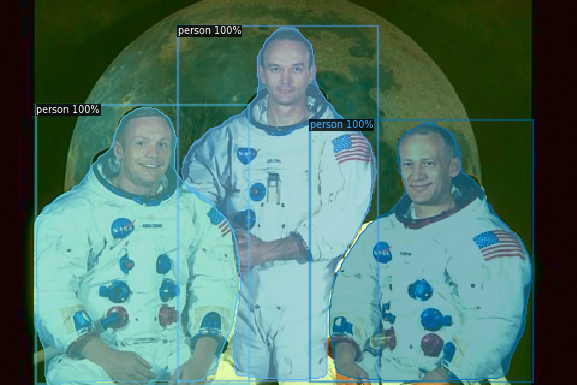

================================================================== ['323016AB_4.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9990461468696594
person -- 0.9984226226806641
person -- 0.9980759620666504
=========================================================backround=========================================================


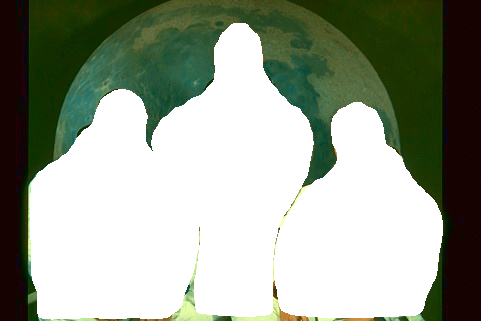

colorfulness 27.735723459142577
Color_cast 0.7126018303791175
***************************************************************************************************************************************
segmented_score 48.61 out of 80
background_score 5.55 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
54.16 %
-------------------------user_rating-------------------------
mean 3.789473684210526
mode 5


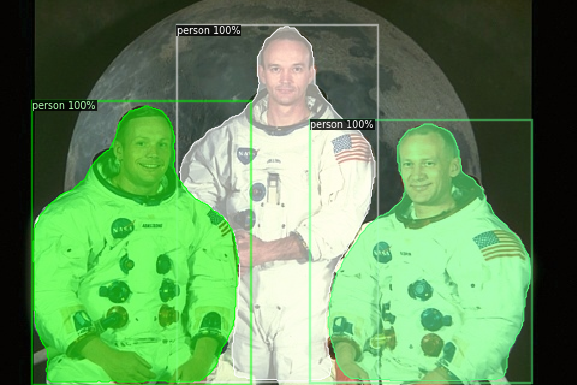

================================================================== ['323016AF_8.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9991682767868042
person -- 0.998923122882843
person -- 0.99853515625
=========================================================backround=========================================================


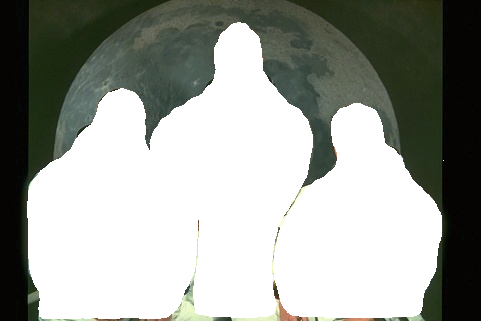

colorfulness 11.504504774228689
Color_cast 0.7741924715661804
***************************************************************************************************************************************
segmented_score 35.66 out of 80
background_score 2.3 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
37.959999999999994 %
-------------------------user_rating-------------------------
mean 4.315789473684211
mode 5


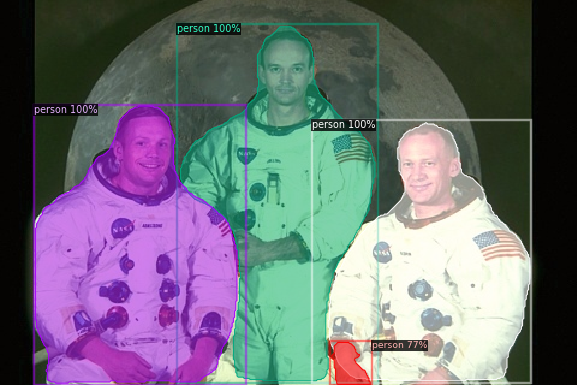

================================================================== ['323016AF_10.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9990237951278687
person -- 0.9988133907318115
person -- 0.998568058013916
person -- 0.7728002071380615
=========================================================backround=========================================================


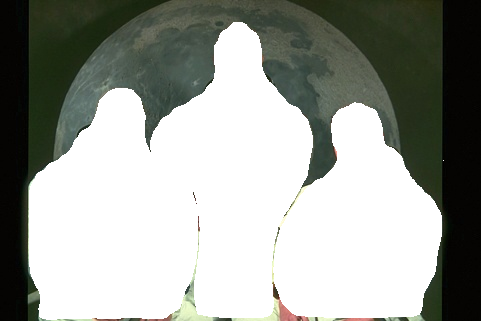

colorfulness 11.735257547485745
Color_cast 0.7687264839170637
***************************************************************************************************************************************
segmented_score 28.16 out of 80
background_score 2.35 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
30.51 %
-------------------------user_rating-------------------------
mean 4.166666666666667
mode 5


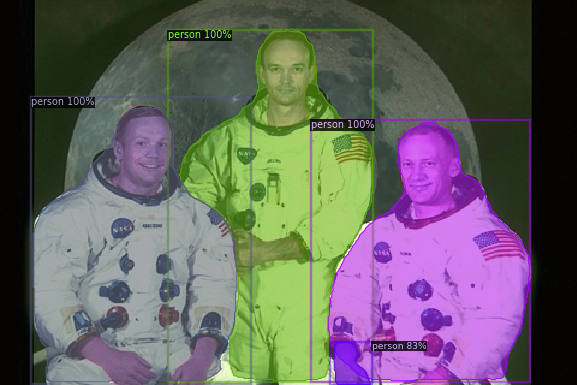

================================================================== ['323016AF_12.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9988670349121094
person -- 0.9985766410827637
person -- 0.9984378218650818
person -- 0.8294654488563538
=========================================================backround=========================================================


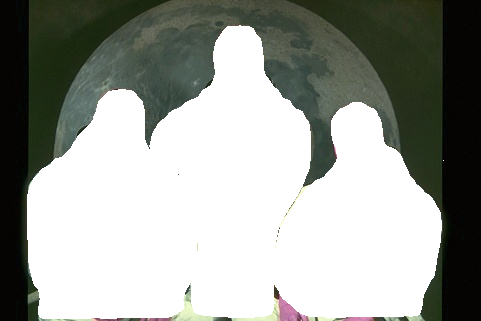

colorfulness 11.389699962775143
Color_cast 0.747894969177078
***************************************************************************************************************************************
segmented_score 13.51 out of 80
background_score 2.28 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
15.79 %
-------------------------user_rating-------------------------
mean 2.3157894736842106
mode 1


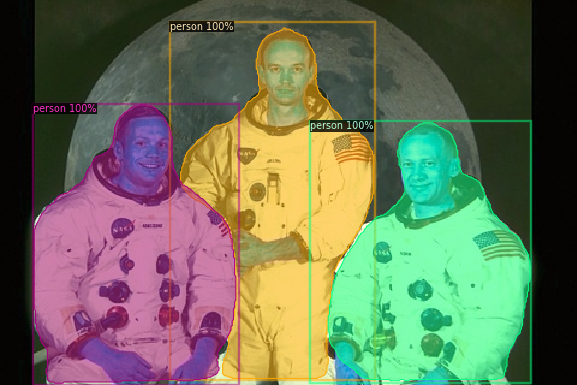

================================================================== ['323016AF_13.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9982078075408936
person -- 0.9981980919837952
person -- 0.9980154037475586
=========================================================backround=========================================================


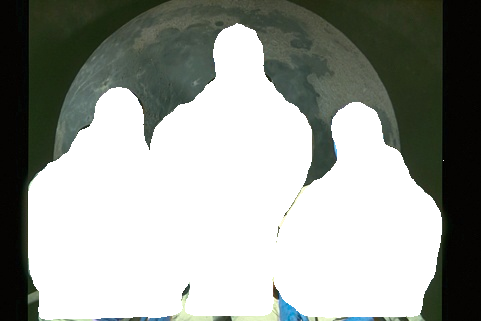

colorfulness 13.34181301398262
Color_cast 0.7526082449823034
***************************************************************************************************************************************
segmented_score 11.62 out of 80
background_score 2.67 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
14.29 %
-------------------------user_rating-------------------------
mean 1.65
mode 1


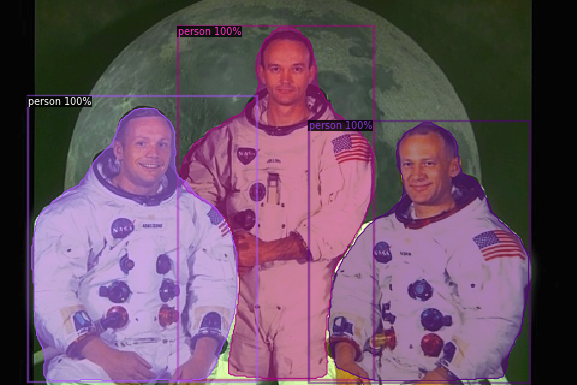

================================================================== ['323016C_3.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9987075328826904
person -- 0.9978856444358826
person -- 0.9969984292984009
=========================================================backround=========================================================


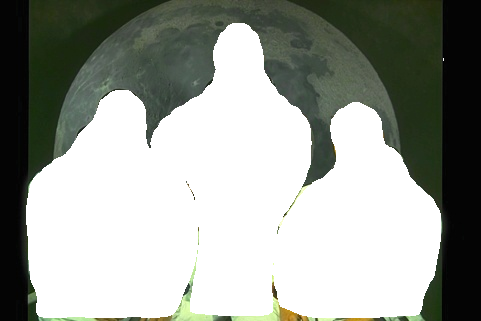

colorfulness 13.99547808737372
Color_cast 0.7526300320035398
***************************************************************************************************************************************
segmented_score 27.99 out of 80
background_score 2.8 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
30.79 %
-------------------------user_rating-------------------------
mean 3.9473684210526314
mode 4


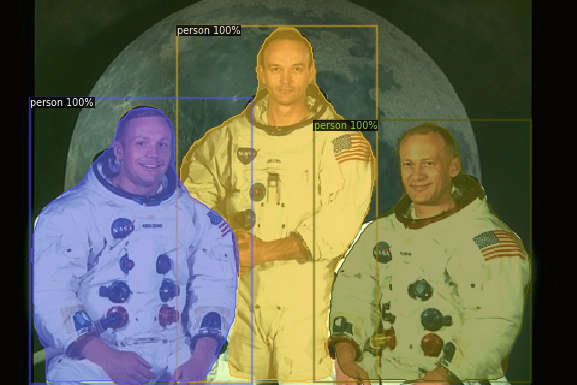

================================================================== ['323016F_8.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9988391995429993
person -- 0.9984866380691528
person -- 0.9982877373695374
=========================================================backround=========================================================


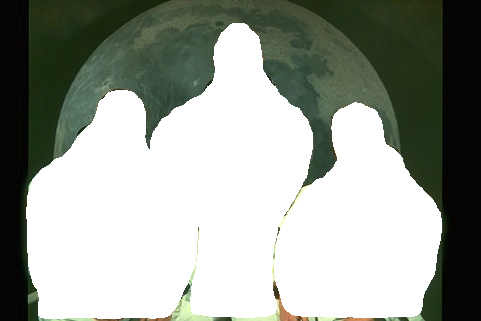

colorfulness 14.834909077142825
Color_cast 0.777203933989786
***************************************************************************************************************************************
segmented_score 32.83 out of 80
background_score 2.97 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
35.8 %
-------------------------user_rating-------------------------
mean 4.25
mode 5
          filename  user_ratings_mean user_ratings_mode  new_colour_value  \
0   323016AB_4.jpg           3.789474                 5             54.16   
1   323016AF_8.jpg           4.315789                 5             37.96   
2  323016AF_10.jpg           4.166667                 5             30.51   
3  323016AF_12.jpg   

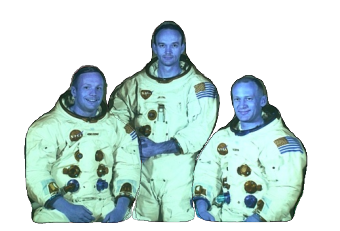

In [ ]:
Test("/content/Dissertation/Test_dataset/323016","323016")

In [ ]:
person_4_astro=pd.read_csv("/content/Dissertation/Test_dataset/results/323016.csv")
person_4_astro

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,object_score,background_score
0,323016AB_4.jpg,3.789474,5,54.16,2.71,60.77,27.74
1,323016AF_8.jpg,4.315789,5,37.96,1.90,44.57,11.50
2,323016AF_10.jpg,4.166667,5,30.51,1.53,35.20,11.74
3,323016AF_12.jpg,2.315789,1,15.79,0.79,16.89,11.39
4,323016AF_13.jpg,1.650000,1,14.29,0.71,14.52,13.34
5,323016C_3.jpg,3.947368,4,30.79,1.54,34.99,14.00
6,323016F_8.jpg,4.250000,5,35.80,1.79,41.04,14.83


In [ ]:
pearsonr_corr(person_4_astro["user_ratings_mean"],person_4_astro["new_colour_value"])
spearmanr_corr(person_4_astro["user_ratings_mean"],person_4_astro["new_colour_value"])

Pearsons correlation: 0.741
spearmanr correlation: 0.607


In [ ]:
pearsonr_corr(person_4_astro["user_ratings_mode"],person_4_astro["new_colour_value"])
spearmanr_corr(person_4_astro["user_ratings_mode"],person_4_astro["new_colour_value"])

Pearsons correlation: 0.845
spearmanr correlation: 0.797


In [ ]:
print("------------User rating correlation for the object-------------")
pearsonr_corr(person_4_astro["user_ratings_mean"],person_4_astro["object_score"])
spearmanr_corr(person_4_astro["user_ratings_mean"],person_4_astro["object_score"])
print("\n")
print("------------User rating correlation for the background-------------")
pearsonr_corr(person_4_astro["user_ratings_mean"],person_4_astro["background_score"])
spearmanr_corr(person_4_astro["user_ratings_mean"],person_4_astro["background_score"])

------------User rating correlation for the object-------------
Pearsons correlation: 0.776
spearmanr correlation: 0.643


------------User rating correlation for the background-------------
Pearsons correlation: 0.147
spearmanr correlation: 0.000


## **118020**

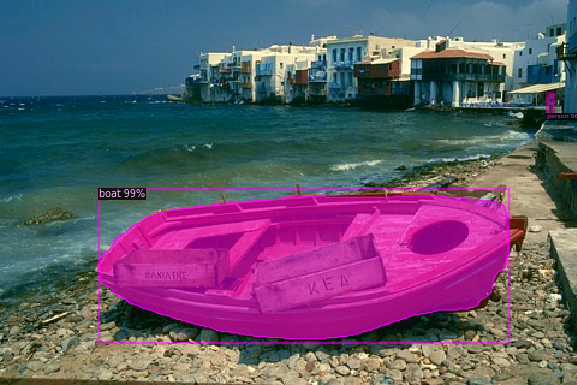

================================================================== ['118020AB_3.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9947559833526611
person -- 0.5589051842689514
=========================================================backround=========================================================


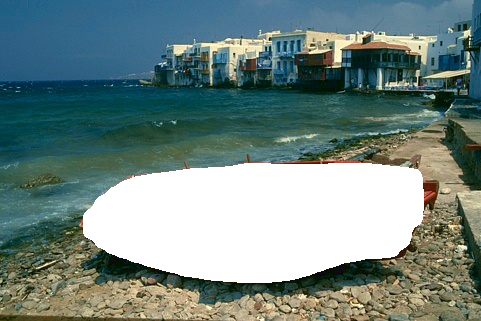

colorfulness 40.42523070479047
Color_cast 0.5852662885632811
***************************************************************************************************************************************
segmented_score 78.07 out of 80
background_score 8.09 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
86.16 %
-------------------------user_rating-------------------------
mean 3.789473684210526
mode 3


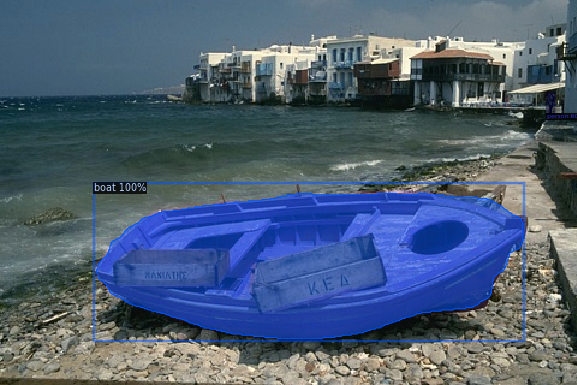

================================================================== ['118020AF_12.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9964470267295837
person -- 0.6036674380302429
=========================================================backround=========================================================


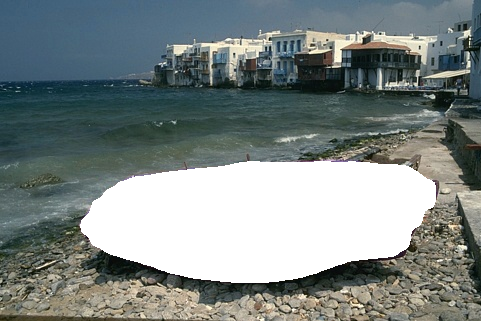

colorfulness 20.925042971627548
Color_cast 0.5595779413698746
***************************************************************************************************************************************
segmented_score 33.15 out of 80
background_score 4.19 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
37.339999999999996 %
-------------------------user_rating-------------------------
mean 3.4210526315789473
mode 2


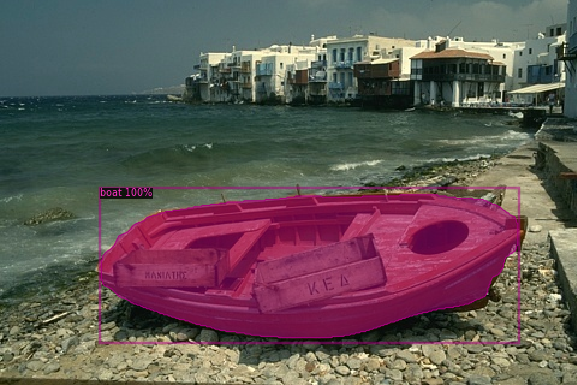

================================================================== ['118020F_3.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9953658580780029
=========================================================backround=========================================================


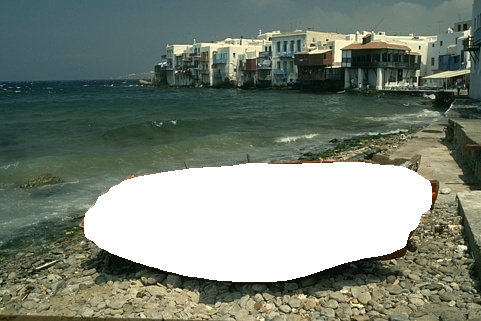

colorfulness 22.230166293882885
Color_cast 1.0719084305096036
***************************************************************************************************************************************
segmented_score 68.9 out of 80
background_score 4.45 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
73.35000000000001 %
-------------------------user_rating-------------------------
mean 4.315789473684211
mode 4


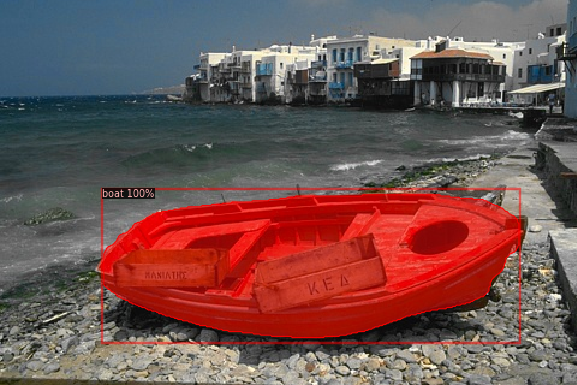

================================================================== ['118020AC_3.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9959839582443237
=========================================================backround=========================================================


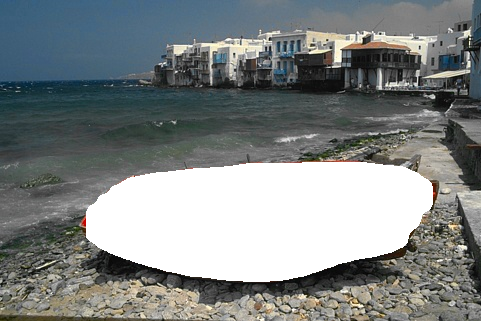

colorfulness 20.701385539844832
Color_cast 0.3517743715452525
***************************************************************************************************************************************
segmented_score 72.56 out of 80
background_score 4.14 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
76.7 %
-------------------------user_rating-------------------------
mean 4.35
mode 5


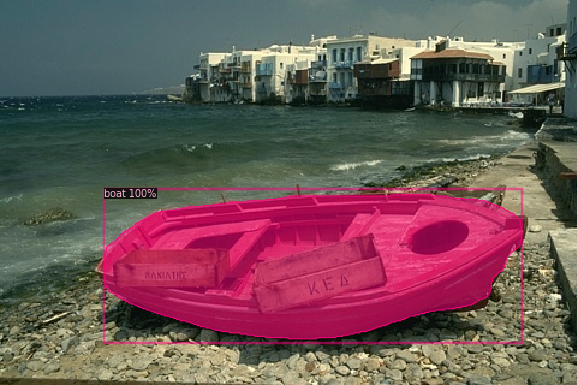

================================================================== ['118020F_8.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9961263537406921
=========================================================backround=========================================================


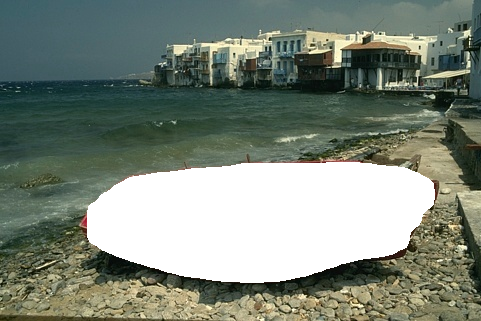

colorfulness 22.25701584869905
Color_cast 1.0630650194024718
***************************************************************************************************************************************
segmented_score 74.5 out of 80
background_score 4.45 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
78.95 %
-------------------------user_rating-------------------------
mean 4.3
mode 5


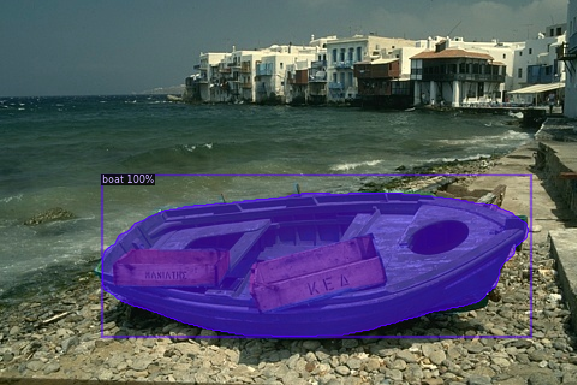

================================================================== ['118020F_11.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9973159432411194
=========================================================backround=========================================================


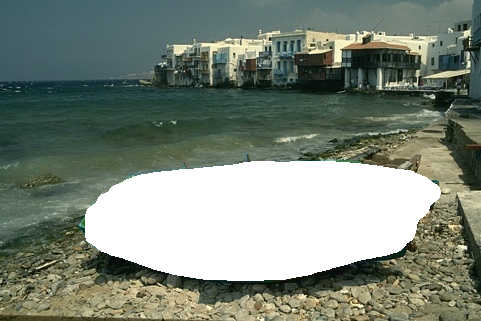

colorfulness 22.129466115844696
Color_cast 1.0782964225681768
***************************************************************************************************************************************
segmented_score 24.71 out of 80
background_score 4.43 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
29.14 %
-------------------------user_rating-------------------------
mean 3.210526315789474
mode 3


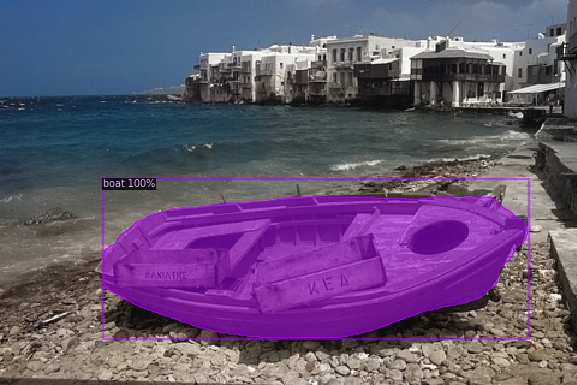

================================================================== ['118020Z_2.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9981984496116638
=========================================================backround=========================================================


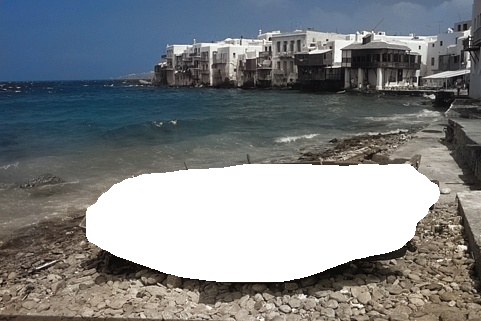

colorfulness 26.973828111922195
Color_cast 0.22770855435687828
***************************************************************************************************************************************
segmented_score 47.5 out of 80
background_score 5.39 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
52.89 %
-------------------------user_rating-------------------------
mean 3.1
mode 3


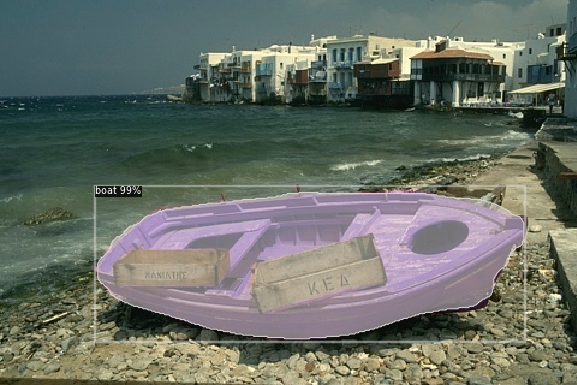

================================================================== ['118020F_12.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9947522878646851
=========================================================backround=========================================================


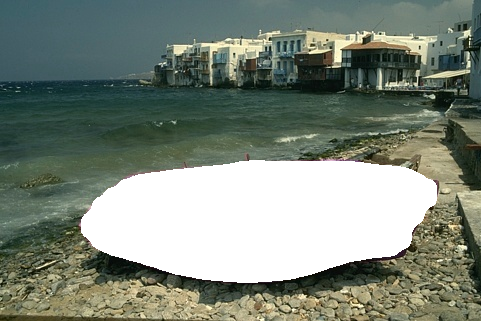

colorfulness 22.04456419368853
Color_cast 1.0578239355816448
***************************************************************************************************************************************
segmented_score 43.04 out of 80
background_score 4.41 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
47.45 %
-------------------------user_rating-------------------------
mean 3.1052631578947367
mode 3
          filename  user_ratings_mean user_ratings_mode  new_colour_value  \
0   118020AB_3.jpg           3.789474                 3             86.16   
1  118020AF_12.jpg           3.421053                 2             37.34   
2    118020F_3.jpg           4.315789                 4             73.35   
3   11

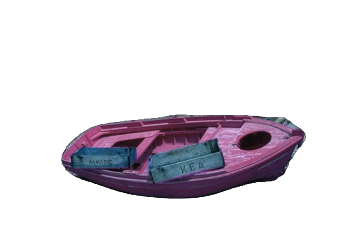

In [ ]:
Test("/content/Dissertation/Test_dataset/118020","118020")

In [ ]:
boat=pd.read_csv("/content/Dissertation/Test_dataset/results/118020.csv")
boat

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,object_score,background_score
0,118020AB_3.jpg,3.789474,3,86.16,97.58,40.43
1,118020AF_12.jpg,3.421053,2,37.34,41.44,20.93
2,118020F_3.jpg,4.315789,4,73.35,86.13,22.23
3,118020AC_3.jpg,4.350000,5,76.70,90.70,20.70
4,118020F_8.jpg,4.300000,5,78.95,93.12,22.26
5,118020F_11.jpg,3.210526,3,29.14,30.89,22.13
6,118020Z_2.jpg,3.100000,3,52.89,59.38,26.97
7,118020F_12.jpg,3.105263,3,47.45,53.81,22.04


In [ ]:
pearsonr_corr(boat["user_ratings_mean"],boat["new_colour_value"])
spearmanr_corr(boat["user_ratings_mean"],boat["new_colour_value"])

Pearsons correlation: 0.789
spearmanr correlation: 0.571


In [ ]:
pearsonr_corr(boat["user_ratings_mode"],boat["new_colour_value"])
spearmanr_corr(boat["user_ratings_mode"],boat["new_colour_value"])

Pearsons correlation: 0.667
spearmanr correlation: 0.600


In [ ]:
print("------------User rating correlation for the object-------------")
pearsonr_corr(boat["user_ratings_mean"],boat["object_score"])
spearmanr_corr(boat["user_ratings_mean"],boat["object_score"])
print("\n")
print("------------User rating correlation for the background-------------")
pearsonr_corr(boat["user_ratings_mean"],boat["background_score"])
spearmanr_corr(boat["user_ratings_mean"],boat["background_score"])

------------User rating correlation for the object-------------
Pearsons correlation: 0.815
spearmanr correlation: 0.571


------------User rating correlation for the background-------------
Pearsons correlation: -0.063
spearmanr correlation: -0.238


## **078019**

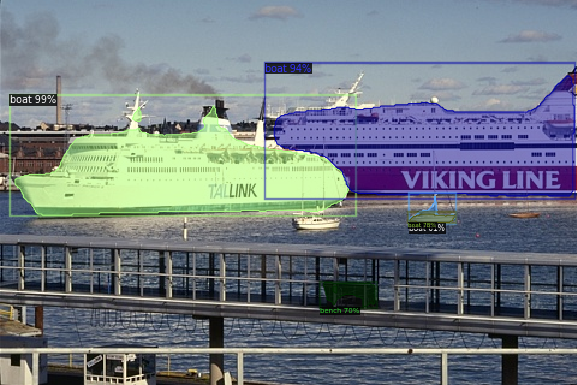

================================================================== ['078019_gt.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9895203113555908
boat -- 0.9372032284736633
boat -- 0.7845484614372253
bench -- 0.6974213719367981
boat -- 0.6124783754348755
=========================================================backround=========================================================


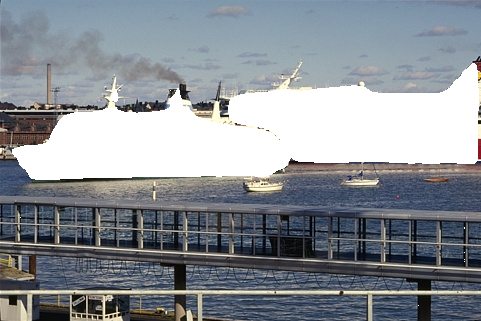

colorfulness 18.141599416885892
Color_cast 0.7255265587074698
***************************************************************************************************************************************
segmented_score 74.75 out of 80
background_score 3.63 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
78.38 %
-------------------------user_rating-------------------------
mean 4.35043409629045
mode 5


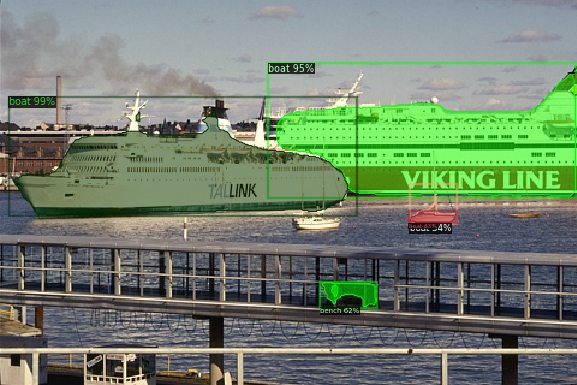

================================================================== ['078019A.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9860910177230835
boat -- 0.954599916934967
boat -- 0.828516960144043
bench -- 0.6235322952270508
boat -- 0.5412968993186951
=========================================================backround=========================================================


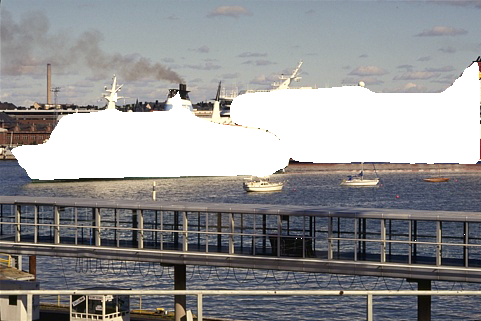

colorfulness 15.990220549878849
Color_cast 0.15355795208954148
***************************************************************************************************************************************
segmented_score 77.33 out of 80
background_score 3.2 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
80.53 %
-------------------------user_rating-------------------------
mean 4.473684210526316
mode 5


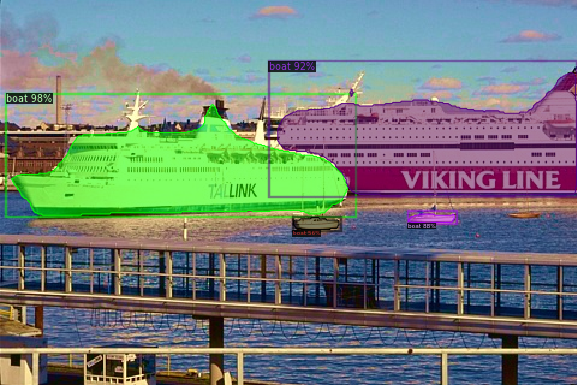

================================================================== ['078019AB_4.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9810175895690918
boat -- 0.9243287444114685
boat -- 0.8808361887931824
boat -- 0.558316171169281
=========================================================backround=========================================================


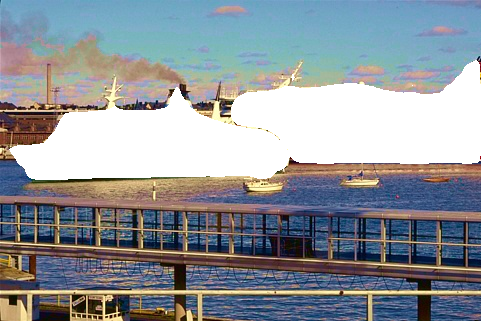

colorfulness 40.602099201920154
Color_cast 0.2559921403942718
***************************************************************************************************************************************
segmented_score 55.25 out of 80
background_score 8.12 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
63.37 %
-------------------------user_rating-------------------------
mean 3.85
mode 4


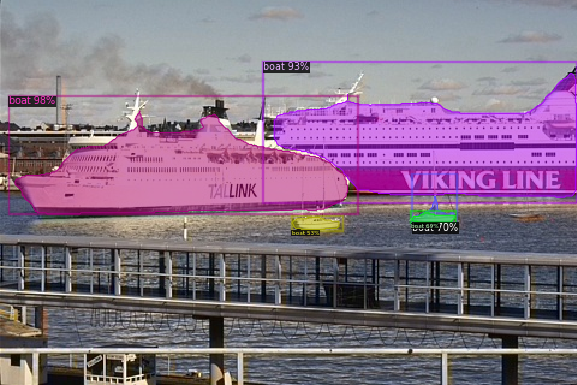

================================================================== ['078019AD_1.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9814452528953552
boat -- 0.928017258644104
boat -- 0.6987907290458679
boat -- 0.6910162568092346
boat -- 0.5293800234794617
=========================================================backround=========================================================


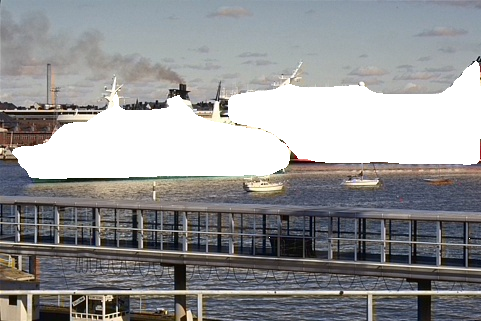

colorfulness 14.355050461284385
Color_cast 0.16476474612968994
***************************************************************************************************************************************
segmented_score 64.12 out of 80
background_score 2.87 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
66.99000000000001 %
-------------------------user_rating-------------------------
mean 4.2105263157894735
mode 4


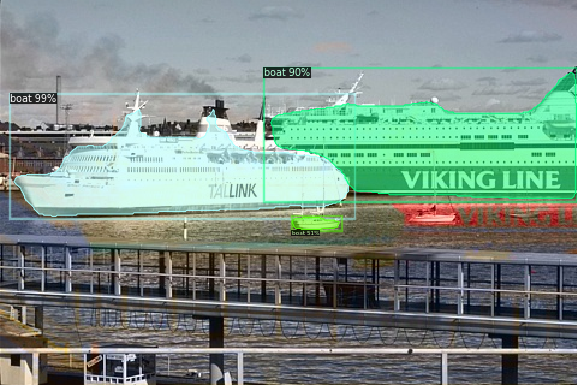

================================================================== ['078019AD_4.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9867511987686157
boat -- 0.895698606967926
boat -- 0.514923095703125
=========================================================backround=========================================================


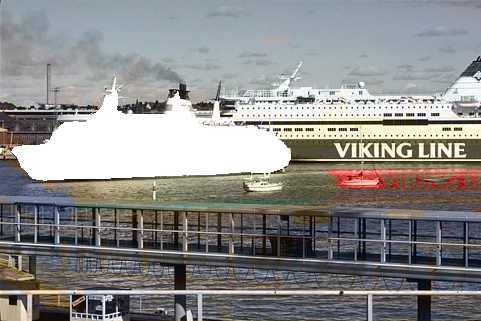

colorfulness 22.052670562183074
Color_cast 0.11895411600110184
***************************************************************************************************************************************
segmented_score 75.15 out of 80
background_score 4.41 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
79.56 %
-------------------------user_rating-------------------------
mean 3.6470588235294117
mode 4


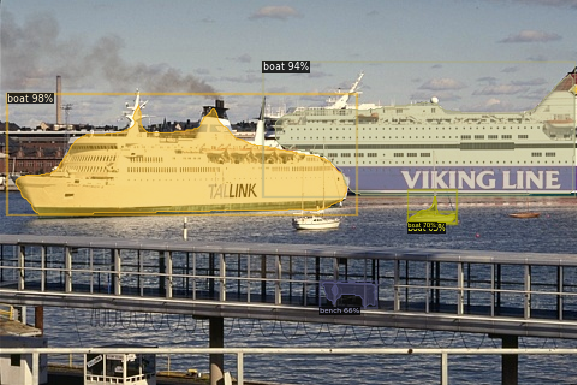

================================================================== ['078019AF_12.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
boat -- 0.9812397956848145
boat -- 0.9353863000869751
boat -- 0.6996493935585022
bench -- 0.660154402256012
boat -- 0.6495270729064941
=========================================================backround=========================================================


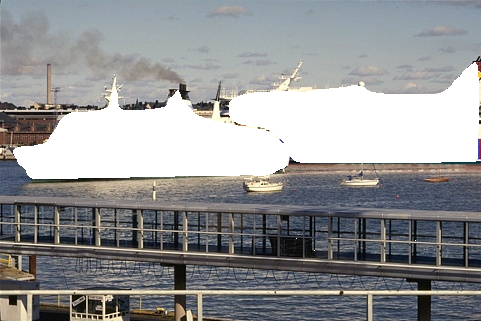

colorfulness 14.727943286675874
Color_cast 0.17185683775022953
***************************************************************************************************************************************
segmented_score 61.7 out of 80
background_score 2.95 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
64.65 %
-------------------------user_rating-------------------------
mean 3.85
mode 3
          filename  user_ratings_mean user_ratings_mode  new_colour_value  \
0    078019_gt.jpg           4.350434                 5             78.38   
1      078019A.jpg           4.473684                 5             80.53   
2   078019AB_4.jpg           3.850000                 4             63.37   
3   078019AD_1.jpg 

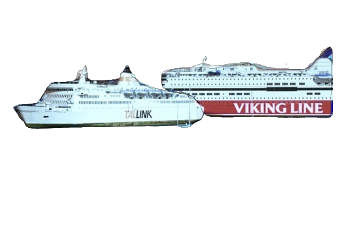

In [ ]:
Test("/content/Dissertation/Test_dataset/078019","078019")

In [ ]:
boat_2=pd.read_csv("/content/diss_test/Test_dataset/results/078019.csv")
boat_2

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,object_score,background_score
0,078019_gt.jpg,4.350434,5,78.38,3.92,93.43,18.14
1,078019A.jpg,4.473684,5,80.53,4.03,96.67,15.99
2,078019AB_4.jpg,3.850000,4,63.37,3.17,69.06,40.60
3,078019AD_1.jpg,4.210526,4,66.99,3.35,80.15,14.36
4,078019AD_4.jpg,3.647059,4,79.56,3.98,93.94,22.05
5,078019AF_12.jpg,3.850000,3,64.65,3.23,77.13,14.73


In [ ]:
pearsonr_corr(boat_2["user_ratings_mean"],boat_2["new_colour_value"])
spearmanr_corr(boat_2["user_ratings_mean"],boat_2["new_colour_value"])

Pearsons correlation: 0.368
spearmanr correlation: 0.406


In [ ]:
pearsonr_corr(boat_2["user_ratings_mode"],boat_2["new_colour_value"])
spearmanr_corr(boat_2["user_ratings_mode"],boat_2["new_colour_value"])

Pearsons correlation: 0.727
spearmanr correlation: 0.648


In [ ]:
print("------------User rating correlation for the object-------------")
pearsonr_corr(boat_2["user_ratings_mean"],boat_2["object_score"])
spearmanr_corr(boat_2["user_ratings_mean"],boat_2["object_score"])
print("\n")
print("------------User rating correlation for the background-------------")
pearsonr_corr(boat_2["user_ratings_mean"],boat_2["background_score"])
spearmanr_corr(boat_2["user_ratings_mean"],boat_2["background_score"])

------------User rating correlation for the object-------------
Pearsons correlation: 0.428
spearmanr correlation: 0.406


------------User rating correlation for the background-------------
Pearsons correlation: -0.435
spearmanr correlation: -0.377


## **065019**

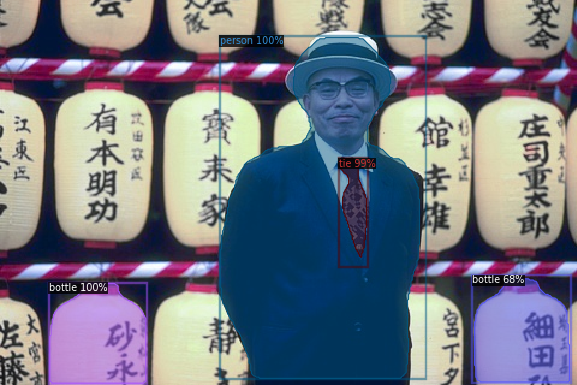

================================================================== ['065019AG_2.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.996785044670105
bottle -- 0.9957594275474548
tie -- 0.9894970655441284
bottle -- 0.6818891763687134
=========================================================backround=========================================================


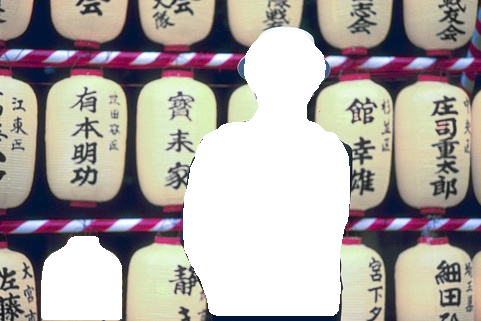

colorfulness 33.12074801928865
Color_cast 0.31797397573646774
***************************************************************************************************************************************
segmented_score 38.02 out of 80
background_score 6.62 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
44.64 %
-------------------------user_rating-------------------------
mean 3.05
mode 3


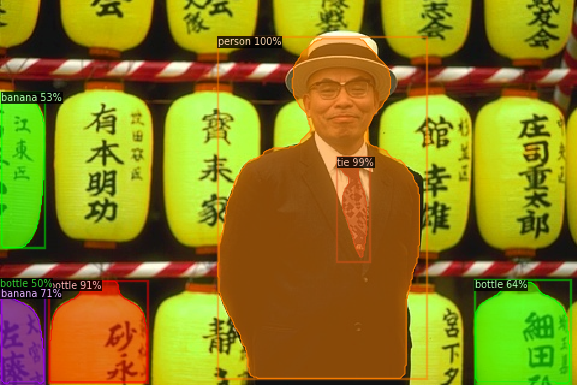

================================================================== ['065019F_7.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9985723495483398
tie -- 0.9919123649597168
bottle -- 0.9092422127723694
banana -- 0.7117929458618164
bottle -- 0.6384680271148682
banana -- 0.5283010601997375
bottle -- 0.5014481544494629
=========================================================backround=========================================================


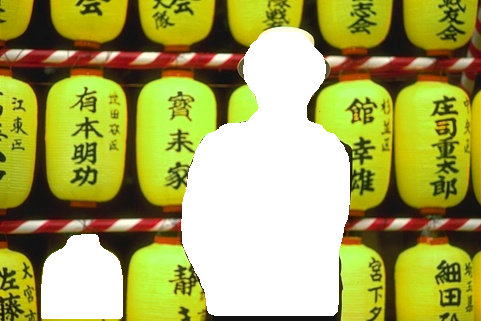

colorfulness 100.19063374557325
Color_cast 1.1342303190673317
***************************************************************************************************************************************
segmented_score 65.79 out of 80
background_score 20.04 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
85.83000000000001 %
-------------------------user_rating-------------------------
mean 3.789473684210526
mode 4


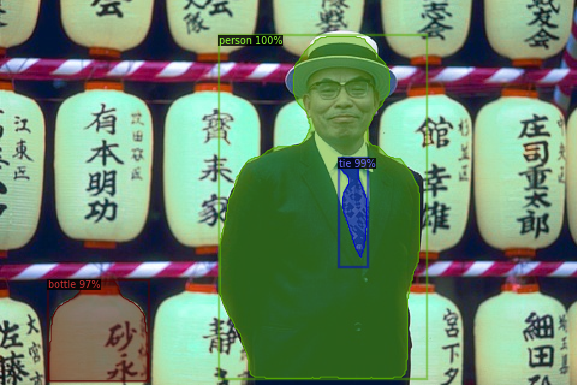

================================================================== ['065019AF_9.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9984108209609985
tie -- 0.9892894625663757
bottle -- 0.9684244990348816
=========================================================backround=========================================================


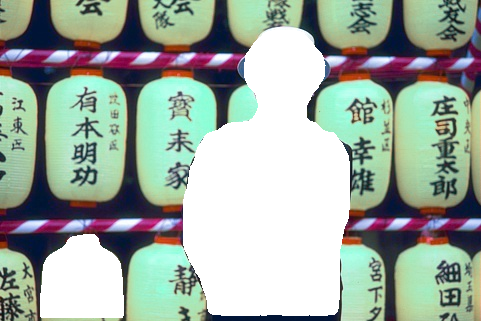

colorfulness 44.33249225075094
Color_cast 0.397648577362545
***************************************************************************************************************************************
segmented_score 19.51 out of 80
background_score 8.87 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
28.380000000000003 %
-------------------------user_rating-------------------------
mean 3.1578947368421053
mode 3


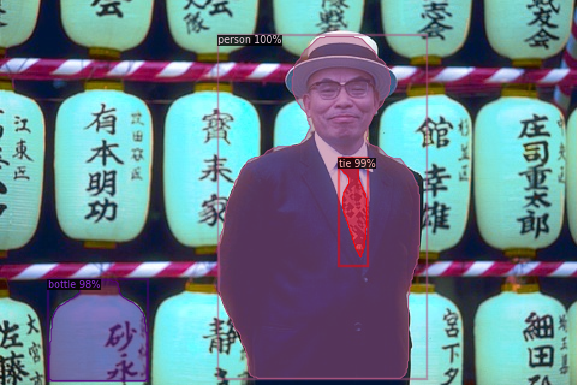

================================================================== ['065019AF_11.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9981208443641663
tie -- 0.989298939704895
bottle -- 0.9824156761169434
=========================================================backround=========================================================


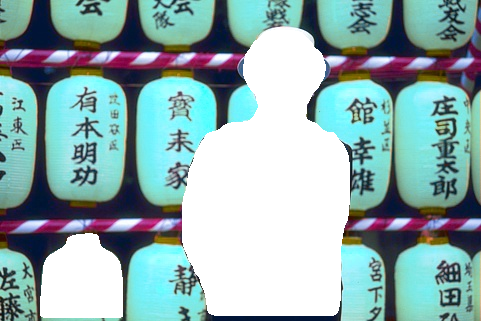

colorfulness 62.01121924363315
Color_cast 0.5451151720358663
***************************************************************************************************************************************
segmented_score 22.15 out of 80
background_score 12.4 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
34.55 %
-------------------------user_rating-------------------------
mean 3.35
mode 3


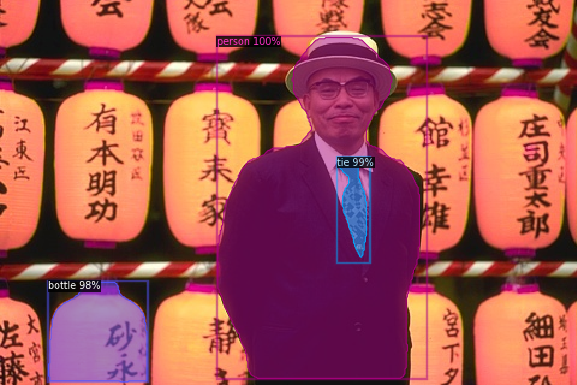

================================================================== ['065019F_10.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9977895021438599
tie -- 0.9922564029693604
bottle -- 0.9837720990180969
=========================================================backround=========================================================


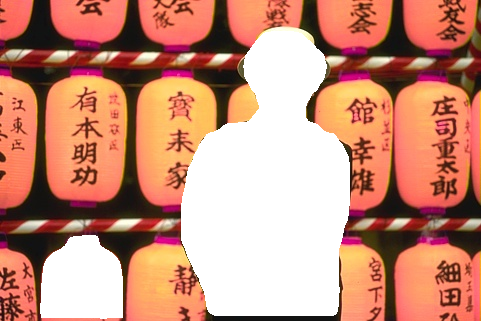

colorfulness 90.68785410774558
Color_cast 1.216088634400868
***************************************************************************************************************************************
segmented_score 63.63 out of 80
background_score 18.14 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
81.77000000000001 %
-------------------------user_rating-------------------------
mean 4
mode 4


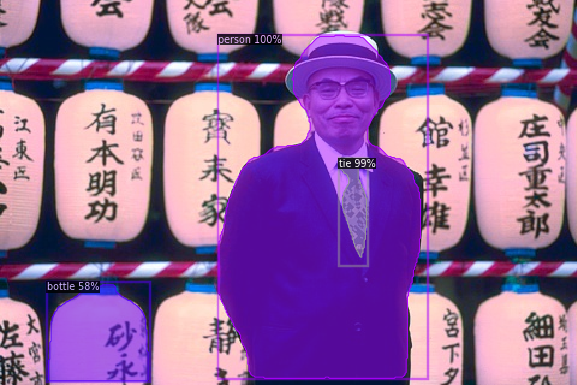

================================================================== ['065019AF_12.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9971749782562256
tie -- 0.9895903468132019
bottle -- 0.5773322582244873
=========================================================backround=========================================================


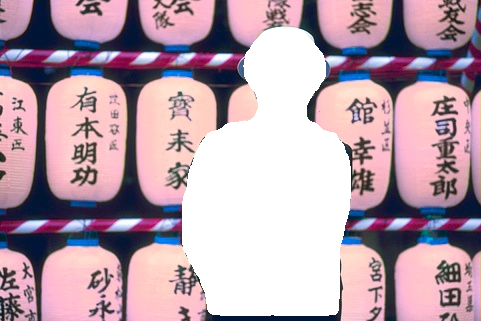

colorfulness 45.147735772809135
Color_cast 1.0133139131910547
***************************************************************************************************************************************
segmented_score 41.42 out of 80
background_score 9.03 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
50.45 %
-------------------------user_rating-------------------------
mean 3.4
mode 3


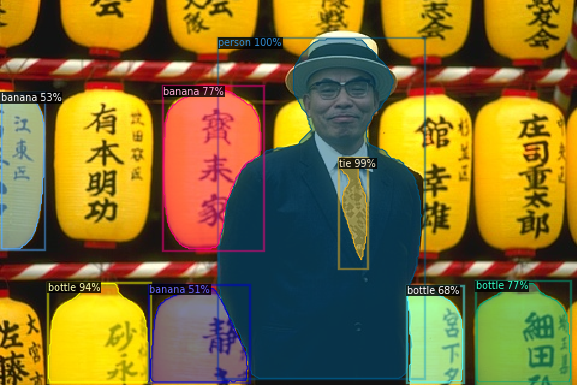

================================================================== ['065019_gt.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.998508632183075
tie -- 0.9930906295776367
bottle -- 0.9402396082878113
banana -- 0.771345853805542
bottle -- 0.7674850225448608
bottle -- 0.6824760437011719
banana -- 0.5278131365776062
banana -- 0.5074894428253174
=========================================================backround=========================================================


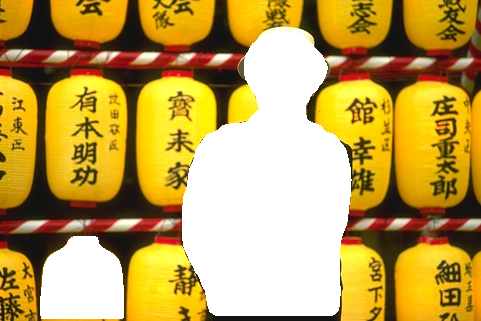

colorfulness 122.95910309154291
Color_cast 1.1866715864551305
***************************************************************************************************************************************
segmented_score 50.37 out of 80
background_score 24.59 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
74.96 %
-------------------------user_rating-------------------------
mean 4.456195737963694
mode 5
          filename  user_ratings_mean user_ratings_mode  new_colour_value  \
0   065019AG_2.jpg           3.050000                 3             44.64   
1    065019F_7.jpg           3.789474                 4             85.83   
2   065019AF_9.jpg           3.157895                 3             28.38   
3  06

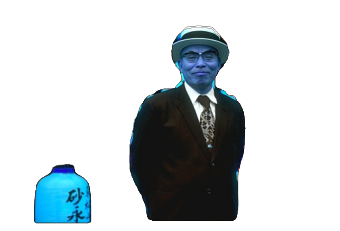

In [ ]:
Test("/content/drive/MyDrive/diss_test/Test_dataset/065019","065019")

In [ ]:
person_2_jap=pd.read_csv("/content/diss_test/Test_dataset/results/065019.csv")
person_2_jap

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,object_score,background_score
0,065019AG_2.jpg,3.050000,3,44.64,2.23,47.53,33.12
1,065019F_7.jpg,3.789474,4,85.83,4.29,82.24,100.19
2,065019AF_9.jpg,3.157895,3,28.38,1.42,24.38,44.33
3,065019AF_11.jpg,3.350000,3,34.55,1.73,27.69,62.01
4,065019F_10.jpg,4.000000,4,81.77,4.09,79.53,90.69
5,065019AF_12.jpg,3.400000,3,50.45,2.52,51.77,45.15
6,065019_gt.jpg,4.456196,5,74.96,3.75,62.96,122.96


In [ ]:
pearsonr_corr(person_2_jap["user_ratings_mean"],person_2_jap["new_colour_value"])
spearmanr_corr(person_2_jap["user_ratings_mean"],person_2_jap["new_colour_value"])

Pearsons correlation: 0.806
spearmanr correlation: 0.750


In [ ]:
pearsonr_corr(person_2_jap["user_ratings_mode"],person_2_jap["new_colour_value"])
spearmanr_corr(person_2_jap["user_ratings_mode"],person_2_jap["new_colour_value"])

Pearsons correlation: 0.802
spearmanr correlation: 0.777


In [ ]:
print("------------User rating correlation for the object-------------")
pearsonr_corr(person_2_jap["user_ratings_mean"],person_2_jap["object_score"])
spearmanr_corr(person_2_jap["user_ratings_mean"],person_2_jap["object_score"])
print("\n")
print("------------User rating correlation for the background-------------")
pearsonr_corr(person_2_jap["user_ratings_mean"],person_2_jap["background_score"])
spearmanr_corr(person_2_jap["user_ratings_mean"],person_2_jap["background_score"])

------------User rating correlation for the object-------------
Pearsons correlation: 0.676
spearmanr correlation: 0.750


------------User rating correlation for the background-------------
Pearsons correlation: 0.958
spearmanr correlation: 0.929


## **376001**

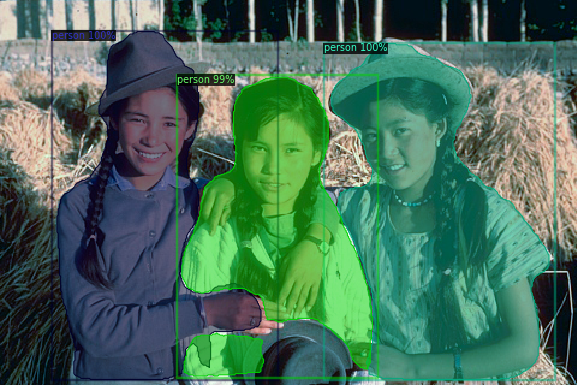

================================================================== ['376001A.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9983200430870056
person -- 0.9976988434791565
person -- 0.9947866201400757
=========================================================backround=========================================================


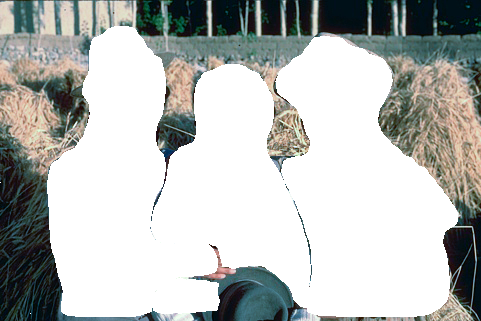

colorfulness 20.229064573261237
Color_cast 0.34230727532789385
***************************************************************************************************************************************
segmented_score 47.35 out of 80
background_score 4.05 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
51.4 %
-------------------------user_rating-------------------------
mean 4
mode 4


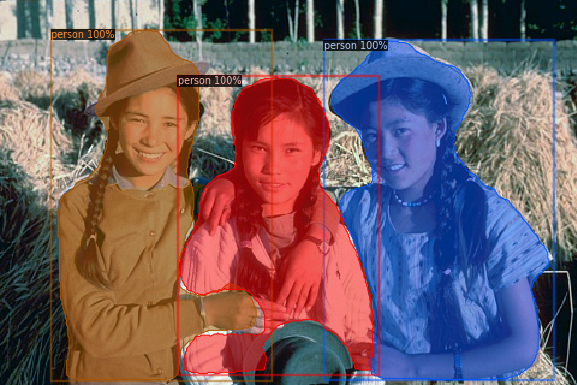

================================================================== ['376001AF_13.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9988532066345215
person -- 0.9984820485115051
person -- 0.9955655932426453
=========================================================backround=========================================================


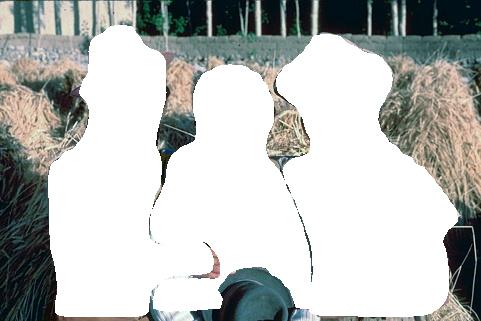

colorfulness 17.850180964918323
Color_cast 0.39440225826288383
***************************************************************************************************************************************
segmented_score 64.58 out of 80
background_score 3.57 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
68.14999999999999 %
-------------------------user_rating-------------------------
mean 4.0588235294117645
mode 5


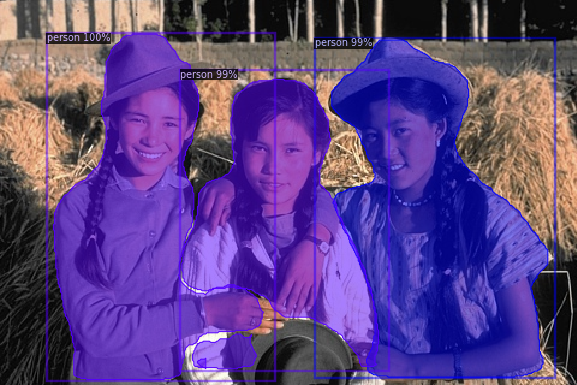

================================================================== ['376001B_2.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9982998967170715
person -- 0.9926804900169373
person -- 0.9883034229278564
=========================================================backround=========================================================


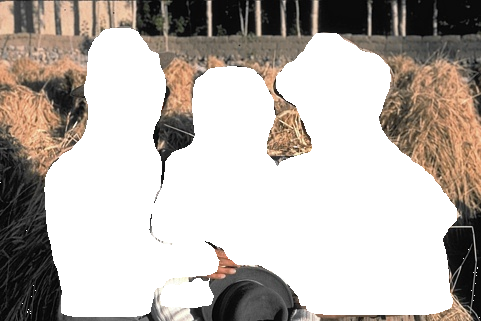

colorfulness 27.550522201727563
Color_cast 0.6759263384289995
***************************************************************************************************************************************
segmented_score 34.06 out of 80
background_score 5.51 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
39.57 %
-------------------------user_rating-------------------------
mean 3.75
mode 3


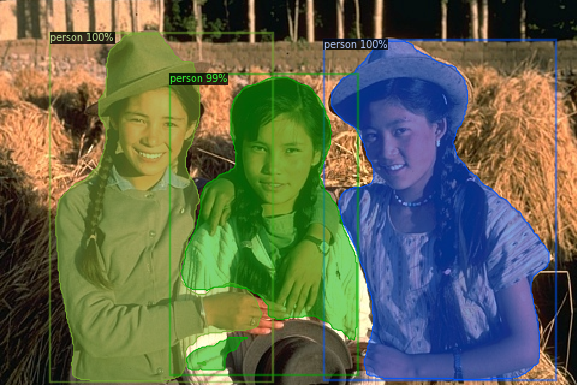

================================================================== ['376001F_2.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9984190464019775
person -- 0.9975874423980713
person -- 0.989437460899353
=========================================================backround=========================================================


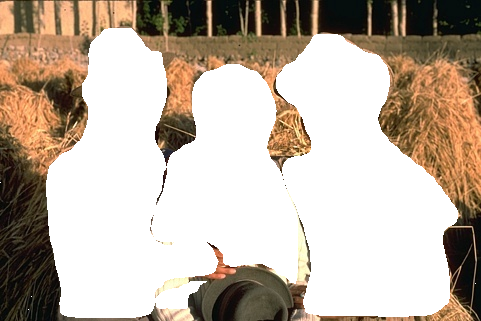

colorfulness 45.296899736844914
Color_cast 0.7828839308228616
***************************************************************************************************************************************
segmented_score 79.53 out of 80
background_score 9.06 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
88.59 %
-------------------------user_rating-------------------------
mean 4.611111111111111
mode 5


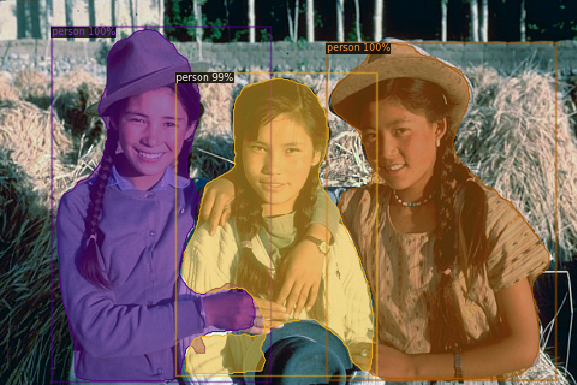

================================================================== ['376001AF_6.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9979192614555359
person -- 0.9972293972969055
person -- 0.9941099286079407
=========================================================backround=========================================================


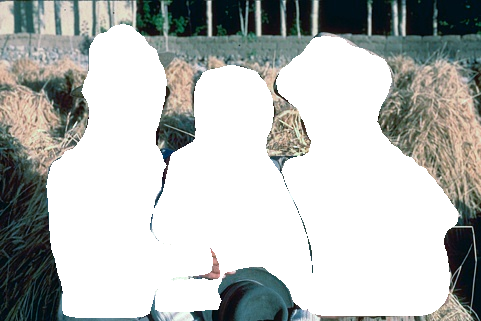

colorfulness 18.03072027022805
Color_cast 0.39485188104639535
***************************************************************************************************************************************
segmented_score 40.73 out of 80
background_score 3.61 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
44.339999999999996 %
-------------------------user_rating-------------------------
mean 4.2
mode 4


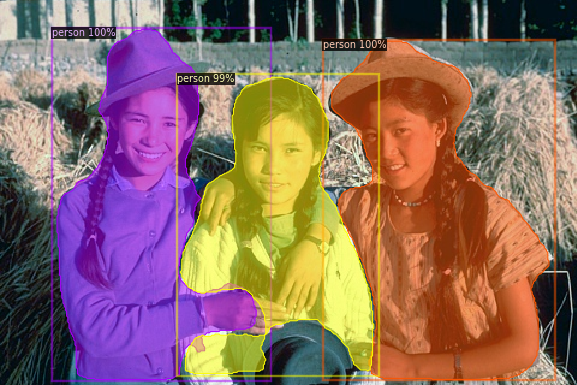

================================================================== ['376001AG_1.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9987913966178894
person -- 0.997564435005188
person -- 0.9932541251182556
=========================================================backround=========================================================


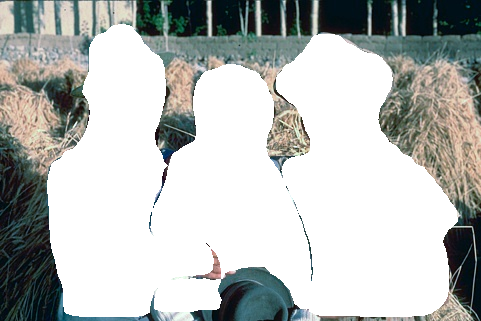

colorfulness 18.55262945930531
Color_cast 0.387973368090776
***************************************************************************************************************************************
segmented_score 47.54 out of 80
background_score 3.71 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
51.25 %
-------------------------user_rating-------------------------
mean 4.3
mode 4


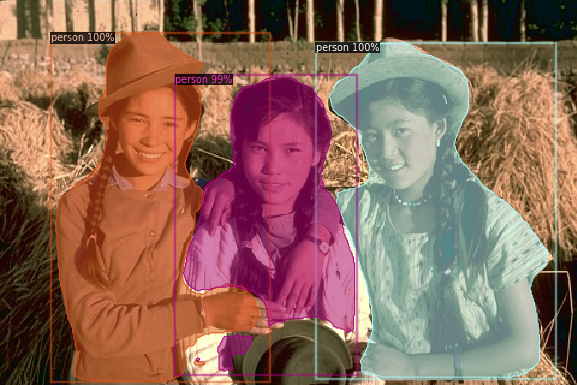

================================================================== ['376001C_2.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9984814524650574
person -- 0.9962754249572754
person -- 0.9895827770233154
=========================================================backround=========================================================


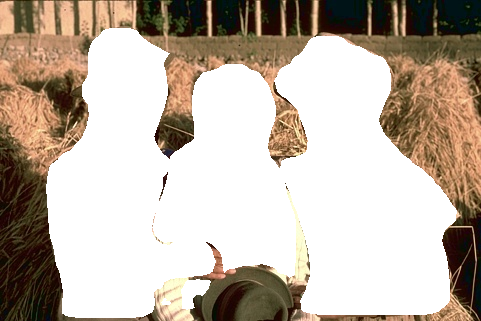

colorfulness 38.14519565478841
Color_cast 0.8125156682170585
***************************************************************************************************************************************
segmented_score 79.67 out of 80
background_score 7.63 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
87.3 %
-------------------------user_rating-------------------------
mean 3.85
mode 4


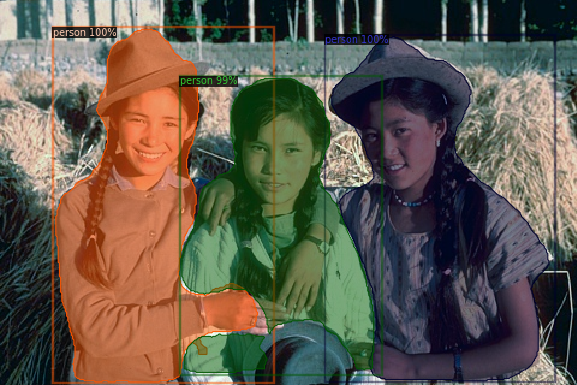

================================================================== ['376001AG_2.jpg'] =====================================================================
=========================================================Predicted class and Accuracy=========================================================
person -- 0.9981757402420044
person -- 0.9979726672172546
person -- 0.994244396686554
=========================================================backround=========================================================


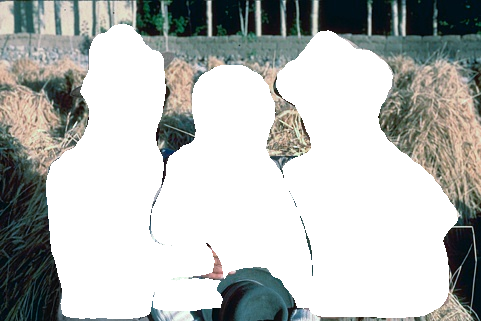

colorfulness 17.798372022062857
Color_cast 0.3937620518378232
***************************************************************************************************************************************
segmented_score 47.07 out of 80
background_score 3.56 out of 20
***************************************************************************************************************************************
===========================================================Score===========================================================
--------------New Score with colourfulness & cast--------------
50.63 %
-------------------------user_rating-------------------------
mean 3.9
mode 4
          filename user_ratings_mean user_ratings_mode  new_colour_value  \
0      376001A.jpg                 4                 4             51.40   
1  376001AF_13.jpg          4.058824                 5             68.15   
2    376001B_2.jpg              3.75                 3             39.57   
3    376001F_2.jpg      

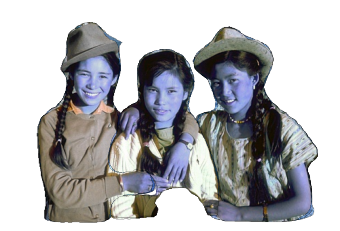

In [ ]:
Test("/content/drive/MyDrive/diss_test/Test_dataset/376001","376001")

In [ ]:
Three_girls=pd.read_csv("/content/diss_test/Test_dataset/results/376001.csv")
Three_girls

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,object_score,background_score
0,376001A.jpg,4.000000,4,51.40,2.57,59.18,20.23
1,376001AF_13.jpg,4.058824,5,68.15,3.41,80.72,17.85
2,376001B_2.jpg,3.750000,3,39.57,1.98,42.58,27.55
3,376001F_2.jpg,4.611111,5,88.59,4.43,99.41,45.30
4,376001AF_6.jpg,4.200000,4,44.34,2.22,50.91,18.03
5,376001AG_1.jpg,4.300000,4,51.25,2.56,59.42,18.55
6,376001C_2.jpg,3.850000,4,87.30,4.36,99.58,38.15
7,376001AG_2.jpg,3.900000,4,50.63,2.53,58.84,17.80


In [ ]:
pearsonr_corr(Three_girls["user_ratings_mean"],Three_girls["new_colour_value"])
spearmanr_corr(Three_girls["user_ratings_mean"],Three_girls["new_colour_value"])

Pearsons correlation: 0.378
spearmanr correlation: 0.381


In [ ]:
pearsonr_corr(Three_girls["user_ratings_mode"],Three_girls["new_colour_value"])
spearmanr_corr(Three_girls["user_ratings_mode"],Three_girls["new_colour_value"])

Pearsons correlation: 0.669
spearmanr correlation: 0.770


# **Standard Deviation, PSNR & SSIM**

## **standard deviation of 078019**

In [ ]:
import statistics
testing_final_classes_1 = testing_final[testing_final["File1"] == "078019AF_12.jpg"]
print(testing_final_classes_1)
print("sd",statistics.stdev(testing_final_classes_1["Score1"]))
print("mean",mean(testing_final_classes_1["Score1"]))

                 File1  Score1
27358  078019AF_12.jpg       5
27398  078019AF_12.jpg       5
27407  078019AF_12.jpg       5
27418  078019AF_12.jpg       3
27438  078019AF_12.jpg       5
27458  078019AF_12.jpg       5
27488  078019AF_12.jpg       3
27509  078019AF_12.jpg       3
27541  078019AF_12.jpg       4
27543  078019AF_12.jpg       5
27596  078019AF_12.jpg       4
27610  078019AF_12.jpg       3
27620  078019AF_12.jpg       3
27633  078019AF_12.jpg       3
27662  078019AF_12.jpg       4
27672  078019AF_12.jpg       3
27691  078019AF_12.jpg       4
27698  078019AF_12.jpg       3
27718  078019AF_12.jpg       4
27738  078019AF_12.jpg       3
sd 0.8750939799154206
mean 3.85


## **PSNR & SSIM**

In [ ]:
from skimage.metrics import structural_similarity as ssim
import argparse
import imutils
import cv2
def SSIM(orginal_SSIM,DUP_SSIM):
  imageA = orginal_SSIM
  imageB = DUP_SSIM

  # 4. Convert the images to grayscale
  grayA = cv2.cvtColor(imageA, cv2.COLOR_BGR2GRAY)
  grayB = cv2.cvtColor(imageB, cv2.COLOR_BGR2GRAY)

  # 5. Compute the Structural Similarity Index (SSIM) between the two
  #    images, ensuring that the difference image is returned
  #(score, diff) = compare_ssim(grayA, grayB, full=True)
  (score, diff) = ssim(grayA, grayB, full=True)
  diff = (diff * 255).astype("uint8")

  # 6. You can print only the score if you want
  #print("SSIM: {}".format(score))
  return score 

from math import log10, sqrt
import cv2
import numpy as np

def PSNR(original, compressed):
	mse = np.mean((original - compressed) ** 2)
	if(mse == 0): # MSE is zero means no noise is present in the signal .
				# Therefore PSNR have no importance.
		return 100
	max_pixel = 255.0
	psnr = 20 * log10(max_pixel / sqrt(mse))
	return psnr	

### **065019**

In [ ]:
person_2=pd.read_csv("/content/Dissertation/Test_dataset/results/065019.csv")
person_2
person_2.insert(5,"PSNR","")
person_2.insert(6,"SSIM","")
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/065019_gt.jpg")
for items,rows in person_2.iterrows():
  filename="/content/Dissertation/Test_dataset/065019/" + person_2["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  person_2["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  person_2["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)

person_2
  


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,065019AG_2.jpg,3.050000,3,44.64,2.23,28.416619,0.983857,47.53,33.12
1,065019F_7.jpg,3.789474,4,85.83,4.29,30.80857,0.993926,82.24,100.19
2,065019AF_9.jpg,3.157895,3,28.38,1.42,28.300343,0.98348,24.38,44.33
3,065019AF_11.jpg,3.350000,3,34.55,1.73,28.383815,0.981229,27.69,62.01
4,065019F_10.jpg,4.000000,4,81.77,4.09,30.534688,0.98465,79.53,90.69
5,065019AF_12.jpg,3.400000,3,50.45,2.52,29.298066,0.976224,51.77,45.15
6,065019_gt.jpg,4.456196,5,74.96,3.75,100,1.0,62.96,122.96


In [ ]:
person_2 = person_2.drop(labels=6, axis=0)
person_2

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,065019AG_2.jpg,3.050000,3,44.64,2.23,28.416619,0.983857,47.53,33.12
1,065019F_7.jpg,3.789474,4,85.83,4.29,30.80857,0.993926,82.24,100.19
2,065019AF_9.jpg,3.157895,3,28.38,1.42,28.300343,0.98348,24.38,44.33
3,065019AF_11.jpg,3.350000,3,34.55,1.73,28.383815,0.981229,27.69,62.01
4,065019F_10.jpg,4.000000,4,81.77,4.09,30.534688,0.98465,79.53,90.69
5,065019AF_12.jpg,3.400000,3,50.45,2.52,29.298066,0.976224,51.77,45.15


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(person_2["user_ratings_mean"],person_2["PSNR"])
spearmanr_corr(person_2["user_ratings_mean"],person_2["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(person_2["user_ratings_mean"],person_2["SSIM"])
spearmanr_corr(person_2["user_ratings_mean"],person_2["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.926
spearmanr correlation: 0.771


------------User rating correlation for the SSIM-------------
Pearsons correlation: 0.433
spearmanr correlation: 0.371


### **078019**

In [ ]:
Boat_2=pd.read_csv("/content/Dissertation/Test_dataset/results/078019.csv")
Boat_2
Boat_2.insert(5,"PSNR","")
Boat_2.insert(6,"SSIM","")
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/078019_gt.jpg")
for items,rows in Boat_2.iterrows():
  filename="/content/Dissertation/Test_dataset/078019/" + Boat_2["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  Boat_2["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  Boat_2["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)

Boat_2

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,078019_gt.jpg,4.350434,5,78.38,3.92,100,1.0,93.43,18.14
1,078019A.jpg,4.473684,5,80.53,4.03,31.873583,0.995318,96.67,15.99
2,078019AB_4.jpg,3.850000,4,63.37,3.17,28.973523,0.988247,69.06,40.60
3,078019AD_1.jpg,4.210526,4,66.99,3.35,30.646217,0.992783,80.15,14.36
4,078019AD_4.jpg,3.647059,4,79.56,3.98,29.889527,0.991741,93.94,22.05
5,078019AF_12.jpg,3.850000,3,64.65,3.23,31.323198,0.994116,77.13,14.73


In [ ]:
Boat_2 = Boat_2.drop(labels=0, axis=0)
Boat_2

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
1,078019A.jpg,4.473684,5,80.53,4.03,31.873583,0.995318,96.67,15.99
2,078019AB_4.jpg,3.850000,4,63.37,3.17,28.973523,0.988247,69.06,40.60
3,078019AD_1.jpg,4.210526,4,66.99,3.35,30.646217,0.992783,80.15,14.36
4,078019AD_4.jpg,3.647059,4,79.56,3.98,29.889527,0.991741,93.94,22.05
5,078019AF_12.jpg,3.850000,3,64.65,3.23,31.323198,0.994116,77.13,14.73


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(Boat_2["user_ratings_mean"],Boat_2["PSNR"])
spearmanr_corr(Boat_2["user_ratings_mean"],Boat_2["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(Boat_2["user_ratings_mean"],Boat_2["SSIM"])
spearmanr_corr(Boat_2["user_ratings_mean"],Boat_2["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.658
spearmanr correlation: 0.667


------------User rating correlation for the SSIM-------------
Pearsons correlation: 0.575
spearmanr correlation: 0.667


### **118020**

In [ ]:
Boat_output=pd.read_csv("/content/Dissertation/Test_dataset/results/118020.csv")
Boat_output
Boat_output.insert(5,"PSNR","")
Boat_output.insert(6,"SSIM","")
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/118020_gt.jpg")
for items,rows in Boat_output.iterrows():
  filename="/content/Dissertation/Test_dataset/118020/" + Boat_output["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  Boat_output["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  Boat_output["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)

Boat_output

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,object_score,PSNR,SSIM,background_score
0,118020AB_3.jpg,3.789474,3,86.16,97.58,30.87109,0.993656,40.43
1,118020AF_12.jpg,3.421053,2,37.34,41.44,31.636438,0.99686,20.93
2,118020F_3.jpg,4.315789,4,73.35,86.13,43.217354,0.998967,22.23
3,118020AC_3.jpg,4.350000,5,76.70,90.70,30.735732,0.991802,20.70
4,118020F_8.jpg,4.300000,5,78.95,93.12,37.213163,0.998848,22.26
5,118020F_11.jpg,3.210526,3,29.14,30.89,35.212808,0.996033,22.13
6,118020Z_2.jpg,3.100000,3,52.89,59.38,29.991953,0.997788,26.97
7,118020F_12.jpg,3.105263,3,47.45,53.81,36.288308,0.998336,22.04


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(Boat_output["user_ratings_mean"],Boat_output["PSNR"])
spearmanr_corr(Boat_output["user_ratings_mean"],Boat_output["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(Boat_output["user_ratings_mean"],Boat_output["SSIM"])
spearmanr_corr(Boat_output["user_ratings_mean"],Boat_output["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.356
spearmanr correlation: 0.262


------------User rating correlation for the SSIM-------------
Pearsons correlation: -0.208
spearmanr correlation: -0.095


### **323016**

In [ ]:
person_4astro=pd.read_csv("/content/Dissertation/Test_dataset/results/323016.csv")
person_4astro
person_4astro.insert(5,"PSNR","")
person_4astro.insert(6,"SSIM","")
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/323016_gt.jpg")
for items,rows in person_4astro.iterrows():
  filename="/content/Dissertation/Test_dataset/323016/" + person_4astro["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  person_4astro["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  person_4astro["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)

person_4astro

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,323016AB_4.jpg,3.789474,5,54.16,2.71,30.725912,0.980301,60.77,27.74
1,323016AF_8.jpg,4.315789,5,37.96,1.90,31.413265,0.992849,44.57,11.50
2,323016AF_10.jpg,4.166667,5,30.51,1.53,31.247252,0.992714,35.20,11.74
3,323016AF_12.jpg,2.315789,1,15.79,0.79,31.323088,0.992583,16.89,11.39
4,323016AF_13.jpg,1.650000,1,14.29,0.71,31.402615,0.988591,14.52,13.34
5,323016C_3.jpg,3.947368,4,30.79,1.54,33.754451,0.994633,34.99,14.00
6,323016F_8.jpg,4.250000,5,35.80,1.79,38.426941,0.995874,41.04,14.83


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(person_4astro["user_ratings_mean"],person_4astro["PSNR"])
spearmanr_corr(person_4astro["user_ratings_mean"],person_4astro["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(person_4astro["user_ratings_mean"],person_4astro["SSIM"])
spearmanr_corr(person_4astro["user_ratings_mean"],person_4astro["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.355
spearmanr correlation: 0.429


------------User rating correlation for the SSIM-------------
Pearsons correlation: 0.221
spearmanr correlation: 0.714


### **153093**

In [ ]:
person_5swim=pd.read_csv("/content/Dissertation/Test_dataset/results/153093.csv")
person_5swim
person_5swim.insert(5,"PSNR","")
person_5swim.insert(6,"SSIM","")
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/323016_gt.jpg")
for items,rows in person_5swim.iterrows():
  filename="/content/Dissertation/Test_dataset/153093/" + person_5swim["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  person_5swim["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  person_5swim["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)

person_5swim

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,153093AB_1.jpg,2.315789,2,34.48,1.72,27.90854,0.17027,39.98,12.49
1,153093_gt.jpg,4.416732,5,85.43,4.27,28.003264,0.170553,93.12,54.65
2,153093AG_1.jpg,4.050000,5,78.66,3.93,27.998008,0.168559,87.21,44.45
3,153093AC_4.jpg,3.368421,3,66.66,3.33,27.963472,0.171526,66.01,69.25
4,153093AF_9.jpg,4.473684,5,73.05,3.65,27.986364,0.168506,82.92,33.57
5,153093D_4.jpg,2.450000,1,63.34,3.17,27.983751,0.170099,69.62,38.18
6,153093F_7.jpg,3.894737,4,78.21,3.91,27.992534,0.170263,86.27,45.97


In [ ]:
person_5swim = person_5swim.drop(labels=1, axis=0)
person_5swim

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,153093AB_1.jpg,2.315789,2,34.48,1.72,27.90854,0.17027,39.98,12.49
2,153093AG_1.jpg,4.050000,5,78.66,3.93,27.998008,0.168559,87.21,44.45
3,153093AC_4.jpg,3.368421,3,66.66,3.33,27.963472,0.171526,66.01,69.25
4,153093AF_9.jpg,4.473684,5,73.05,3.65,27.986364,0.168506,82.92,33.57
5,153093D_4.jpg,2.450000,1,63.34,3.17,27.983751,0.170099,69.62,38.18
6,153093F_7.jpg,3.894737,4,78.21,3.91,27.992534,0.170263,86.27,45.97


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(person_5swim["user_ratings_mean"],person_5swim["PSNR"])
spearmanr_corr(person_5swim["user_ratings_mean"],person_5swim["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(person_5swim["user_ratings_mean"],person_5swim["SSIM"])
spearmanr_corr(person_5swim["user_ratings_mean"],person_5swim["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.683
spearmanr correlation: 0.771


------------User rating correlation for the SSIM-------------
Pearsons correlation: -0.554
spearmanr correlation: -0.714


### **198023**

In [ ]:
person_6girl=pd.read_csv("/content/Dissertation/Test_dataset/results/198023.csv")
person_6girl
person_6girl.insert(5,"PSNR","")
person_6girl.insert(6,"SSIM","")
i=0
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/198023_gt.jpg")
for items,rows in person_6girl.iterrows():
  filename="/content/Dissertation/Test_dataset/198023/" + person_6girl["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  person_6girl["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  person_6girl["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)
person_6girl

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,198023_gt.jpg,4.243094,5,67.76,3.39,100,1.0,81.51,12.73
1,198023B_1.jpg,3.200000,2,20.10,1.00,30.936324,0.994598,25.05,0.31
2,198023AB_1.jpg,3.350000,3,20.91,1.05,30.353497,0.991573,25.90,0.94
3,198023B_3.jpg,3.350000,3,80.32,4.02,30.113483,0.976853,93.52,27.50
4,198023C_4.jpg,2.666667,1,41.30,2.06,31.089808,0.972069,50.27,5.39
5,198023I_1.jpg,3.350000,4,80.38,4.02,29.170254,0.993472,96.43,16.21
6,198023P_1.jpg,3.850000,4,75.45,3.77,29.434563,0.991013,88.34,23.92


In [ ]:
person_6girl = person_6girl.drop(labels=0, axis=0)
person_6girl

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
1,198023B_1.jpg,3.200000,2,20.10,1.00,30.936324,0.994598,25.05,0.31
2,198023AB_1.jpg,3.350000,3,20.91,1.05,30.353497,0.991573,25.90,0.94
3,198023B_3.jpg,3.350000,3,80.32,4.02,30.113483,0.976853,93.52,27.50
4,198023C_4.jpg,2.666667,1,41.30,2.06,31.089808,0.972069,50.27,5.39
5,198023I_1.jpg,3.350000,4,80.38,4.02,29.170254,0.993472,96.43,16.21
6,198023P_1.jpg,3.850000,4,75.45,3.77,29.434563,0.991013,88.34,23.92


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(person_6girl["user_ratings_mean"],person_6girl["PSNR"])
spearmanr_corr(person_6girl["user_ratings_mean"],person_6girl["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(person_6girl["user_ratings_mean"],person_6girl["SSIM"])
spearmanr_corr(person_6girl["user_ratings_mean"],person_6girl["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: -0.751
spearmanr correlation: -0.820


------------User rating correlation for the SSIM-------------
Pearsons correlation: 0.599
spearmanr correlation: 0.091


### **239096**

In [ ]:
person_7girlsmile=pd.read_csv("/content/Dissertation/Test_dataset/results/239096.csv")
person_7girlsmile
person_7girlsmile.insert(5,"PSNR","")
person_7girlsmile.insert(6,"SSIM","")
i=0
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/239096_gt.jpg")
for items,rows in person_7girlsmile.iterrows():
  filename="/content/Dissertation/Test_dataset/239096/" + person_7girlsmile["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  person_7girlsmile["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  person_7girlsmile["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)
person_7girlsmile

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,239096_gt.jpg,4.277032,5,78.09,3.90,100,1.0,82.78,59.31
1,239096Z_1.jpg,3.800000,5,86.08,4.30,28.767818,0.984865,98.83,35.09
2,239096AB_3.jpg,2.850000,2,19.65,0.98,28.417837,0.965932,3.67,83.59
3,239096AD_4.jpg,2.900000,2,15.87,0.79,28.531708,0.970253,7.30,50.17
4,239096AC_4.jpg,2.600000,2,36.93,1.85,28.599345,0.935902,19.11,108.21
5,239096F_2.jpg,3.473684,3,71.05,3.55,39.736385,0.996554,74.66,56.60
6,239096F_12.jpg,3.500000,5,79.12,3.96,32.16286,0.974242,79.95,75.82


In [ ]:
person_7girlsmile = person_7girlsmile.drop(labels=0, axis=0)
person_7girlsmile

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
1,239096Z_1.jpg,3.800000,5,86.08,4.30,28.767818,0.984865,98.83,35.09
2,239096AB_3.jpg,2.850000,2,19.65,0.98,28.417837,0.965932,3.67,83.59
3,239096AD_4.jpg,2.900000,2,15.87,0.79,28.531708,0.970253,7.30,50.17
4,239096AC_4.jpg,2.600000,2,36.93,1.85,28.599345,0.935902,19.11,108.21
5,239096F_2.jpg,3.473684,3,71.05,3.55,39.736385,0.996554,74.66,56.60
6,239096F_12.jpg,3.500000,5,79.12,3.96,32.16286,0.974242,79.95,75.82


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(person_7girlsmile["user_ratings_mean"],person_7girlsmile["PSNR"])
spearmanr_corr(person_7girlsmile["user_ratings_mean"],person_7girlsmile["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(person_7girlsmile["user_ratings_mean"],person_7girlsmile["SSIM"])
spearmanr_corr(person_7girlsmile["user_ratings_mean"],person_7girlsmile["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.426
spearmanr correlation: 0.600


------------User rating correlation for the SSIM-------------
Pearsons correlation: 0.818
spearmanr correlation: 0.829


### **376001**

In [ ]:
threegirls=pd.read_csv("/content/Dissertation/Test_dataset/results/376001.csv")
threegirls
threegirls.insert(5,"PSNR","")
threegirls.insert(6,"SSIM","")
i=0
orginal_file_name=cv2.imread("/content/Dissertation/Test_dataset/gt/376001_gt.jpg")
for items,rows in threegirls.iterrows():
  filename="/content/Dissertation/Test_dataset/376001/" + threegirls["filename"][items]
  compressed_filename=cv2.imread(filename, 1)
  threegirls["PSNR"][items]=PSNR(orginal_file_name, compressed_filename)
  threegirls["SSIM"][items]=SSIM(orginal_file_name, compressed_filename)
threegirls

,filename,user_ratings_mean,user_ratings_mode,new_colour_value,out_of_5,PSNR,SSIM,object_score,background_score
0,376001A.jpg,4.000000,4,51.40,2.57,28.324459,0.98916,59.18,20.23
1,376001AF_13.jpg,4.058824,5,68.15,3.41,28.13192,0.987585,80.72,17.85
2,376001B_2.jpg,3.750000,3,39.57,1.98,29.225978,0.998678,42.58,27.55
3,376001F_2.jpg,4.611111,5,88.59,4.43,41.919186,0.999061,99.41,45.30
4,376001AF_6.jpg,4.200000,4,44.34,2.22,28.067571,0.988453,50.91,18.03
5,376001AG_1.jpg,4.300000,4,51.25,2.56,27.993291,0.988139,59.42,18.55
6,376001C_2.jpg,3.850000,4,87.30,4.36,32.316652,0.997227,99.58,38.15
7,376001AG_2.jpg,3.900000,4,50.63,2.53,28.007408,0.98819,58.84,17.80


In [ ]:
print("------------User rating correlation for the PSNR-------------")
pearsonr_corr(threegirls["user_ratings_mean"],threegirls["PSNR"])
spearmanr_corr(threegirls["user_ratings_mean"],threegirls["PSNR"])
print("\n")
print("------------User rating correlation for the SSIM-------------")
pearsonr_corr(threegirls["user_ratings_mean"],threegirls["SSIM"])
spearmanr_corr(threegirls["user_ratings_mean"],threegirls["SSIM"])

------------User rating correlation for the PSNR-------------
Pearsons correlation: 0.623
spearmanr correlation: -0.167


------------User rating correlation for the SSIM-------------
Pearsons correlation: 0.007
spearmanr correlation: -0.167


# **Final_output**

In [ ]:
from prettytable import PrettyTable
mean_table = PrettyTable(['Filename', 'pearson correlation',"Spearman correlation"])
mode_table = PrettyTable(['Filename', 'pearson correlation',"Spearman correlation"])
for file in glob.glob("/content/Dissertation/Test_dataset/results/*.csv"):
  result_file=pd.read_csv(file)

  #correlation for user rating mean and algorithms score
  pearsonr_correlation,_= pearsonr(result_file["user_ratings_mean"],result_file["new_colour_value"])
  Spearman_correlation = (scipy.stats.spearmanr(result_file["user_ratings_mean"],result_file["new_colour_value"])[0])
  mean_table.add_row([file[43:-4], round(pearsonr_correlation,3), round(Spearman_correlation,3)])

  #correlation for user rating mode and algorithms score
  pearsonr_correlation,_= pearsonr(result_file["user_ratings_mode"],result_file["new_colour_value"])
  Spearman_correlation = (scipy.stats.spearmanr(result_file["user_ratings_mode"],result_file["new_colour_value"])[0])
  mode_table.add_row([file[43:-4], round(pearsonr_correlation,3), round(Spearman_correlation,3)])

print("Correlation for user rating mean and algorithms score")
print(mean_table,"\n\n")
print("Correlation for user rating mode and algorithms score")
print(mode_table)

Correlation for user rating mean and algorithms score
+----------+---------------------+----------------------+
| Filename | pearson correlation | Spearman correlation |
+----------+---------------------+----------------------+
|  198023  |        0.444        |        0.408         |
|  323016  |        0.741        |        0.607         |
|  239096  |        0.837        |         0.75         |
|  153093  |        0.841        |        0.786         |
|  376001  |        0.378        |        0.381         |
|  078019  |        0.368        |        0.406         |
|  065019  |        0.806        |         0.75         |
|  118020  |        0.789        |        0.571         |
+----------+---------------------+----------------------+ 


Correlation for user rating mode and algorithms score
+----------+---------------------+----------------------+
| Filename | pearson correlation | Spearman correlation |
+----------+---------------------+----------------------+
|  198023  |       